## "Hyperparameter optimization by [Optuna](https://tech.preferred.jp/en/blog/lightgbm-tuner-new-optuna-integration-for-hyperparameter-optimization/) on [Evaluation Custom Metrics](https://www.kaggle.com/c/jane-street-market-prediction/overview/evaluation)"

### Point at issue:
1. Based on this notebook, I added CatBoost to create [Optimized LightGBM & CatBoost Classifier Models](https://www.kaggle.com/satorushibata/optimized-lightgbm-catboost-classifier-models?scriptVersionId=50786113).
1. After all, what exactly are the [Custom Metrics in this competition](https://www.kaggle.com/c/jane-street-market-prediction/overview/evaluation) ?
1. Please let me know your opinion.

### Quote from [Approx. Utility score for Regression Objective Fnc](https://www.kaggle.com/anlgrbz/approx-utility-score-for-regression-objective-fnc#Custom-Objective-Function-Implementations-for-LGBM) on Utility Score
### Thank you, [@Anil](https://www.kaggle.com/anlgrbz) & [@Amedeo Biolatti](https://www.kaggle.com/abiolatti) !!

> ### Proxy Metrics for Utility Score to Use in Regression 
> ### &
> ### Custom Objective Function Implementations for LGBM


> #### Why regression might be more appropriate?
> In this notebook, I will create proxy metrics to turn classification task into a regression task. I wanted to try and see the effect of structuring this problem as a regression problem instead of classification because "resp" includes more information compared to a binary label as "action". 


> #### How those Custom Objective Functions are related with Evaluation Metric i.e Utility Score?

> I started with adding variations of penalty terms to MSE and MAE if predicted "resp" and true "resp" doesn't have the same sign. This modification is for assigning specific importance for the match between predicted "action" and the true "action" on top of the penalty due to residuals between predicted and actual "resp". This property would allow those new metrics to be used as a proxy to Utility score in a regression setting.


> #### Modified MSE Derivation

> $$Modified MSE = f(\hat{y}) = \sum_{j}(y_j - \hat{y}_j)^2 + \left\{
> \begin{array}{ll}
     >  0  &, y . \hat{y}_j > 0 ; \\
     >  - \lambda . y_j . \hat{y}_j   &, y_j . \hat{y}_j \leq 0 \\
> \end{array} 
> \right.$$

> $y_j$ :  True "resp" value for row j.

> $\hat{y}_j$ :  Predicted "resp" value for row j.

> $ \lambda $ : Parameter to control amount of penalty for non matching action predictions. Needs to be tuned.

> **Piecewise part of the metric represents the extra penalty for non matching true and predicted action. If predicted and true "resp" doesn't have the same label, their multiplication will be smaller than 0 and piecewise function will add extra penalty of $y . \hat{y}$**


> ### Gradient and Hessian 
> I will be implementing objective functions of the different variants of Modified MSE type hybrid metrics in the code below but before starting that part, I wanted to calculate the gradient and hessian for this example -- as gradient and hessian is required to be calculated for objective funcitons in LGBM. 

> $$ Gradient  Modified MSE =  \frac{\partial f(\hat{y})}{\partial \hat{y}} = \sum_{j} -2(y_j - \hat{y}_j) + \left\{
> \begin{array}{ll}
      > 0  &, y . \hat{y}_j > 0 \\
      > - \lambda . y_j   &, y_j . \hat{y}_j \leq 0 \\
> \end{array} 
> \right.$$

> $$ Hessian  Modified MSE = \frac{\partial^2 f(\hat{y})}{\partial \hat{y}^2} = 2 $$

> There are 2 requirement for an objective function which are ;

> - It should be differentiable to first and second level wrt. $\hat{y}_j$ as those derivatives will be gradient and hessian to be used in the underlying optimisation algorithm to minimize objective function.

> - Being differentiable implies another condition which is being continous.

> We can quickly have a look at the shape of those objective functions using a 3-d plot. I will set $\lambda = 2$ to be able to visualise in 3-d

In [1]:
import numpy as np # linear algebra
import plotly.graph_objects as go
lmbda = 2
x = np.outer(np.linspace(-0.5, 0.5, 30), np.ones(30))
y = x.copy().T # transpose
z=np.where(x*y>=0, (y-x)**2, ((y-x)**2) - (x*y)*lmbda )
#z = (y-x)**2 -x*y

trace = go.Surface(x = x, y = y, z =z )
data = [trace]
layout = go.Layout(title = '3D Surface plot')
fig = go.Figure(data = data)
fig.update_layout(title='MSE Modified 1 Objective function values', autosize=False,
                  width=500, height=500,
                  margin=dict(l=80, r=70, b=85, t=110),
scene = dict(xaxis_title='Predicted resp',yaxis_title='True resp',zaxis_title='Value of Objective Function'))
fig.show()

> Given that resp is ranged between -0.5 and 0.5 in the training set, I restricted those axis on $|resp_{pred}|<0.5$ and $|resp_{true}|<0.5$.

In [2]:
lmbda = 2
x = np.outer(np.linspace(-0.5, 0.5, 30), np.ones(30))
y = x.copy().T # transpose
z=np.where(x*y>=0, abs(y-x), abs(y-x) - (x*y)*lmbda )
trace = go.Surface(x = x, y = y, z =z )
data = [trace]
layout = go.Layout(title = '3D Surface plot')
fig = go.Figure(data = data)
fig.update_layout(title='MAE Modified 1 Objective function values', autosize=False,
                  width=500, height=500,
                  margin=dict(l=80, r=70, b=85, t=110),
scene = dict(xaxis_title='Predicted resp',yaxis_title='True resp',zaxis_title='Value of Objective Function'))
fig.show()

In [3]:
%%time
import datatable as dt
import pandas as pd
import os
import random
import seaborn as sns
import janestreet
import warnings
warnings.filterwarnings('ignore')
from tqdm.notebook import tqdm
import plotly.graph_objects as go
from sklearn.model_selection import TimeSeriesSplit, KFold, train_test_split
from sklearn.model_selection._split import _BaseKFold, indexable, _num_samples
from sklearn.utils.validation import _deprecate_positional_args
import re
import pickle
from tqdm.notebook import tqdm
import lightgbm as lgb
import optuna
from optuna.samplers import TPESampler
import multiprocessing
%matplotlib inline
import matplotlib.pyplot as plt
import numba
import datatable as dtable
from sklearn.utils import resample
from scipy.special import logit, expit

CPU times: user 1.12 s, sys: 307 ms, total: 1.42 s
Wall time: 3.07 s


# Initial conditions

In [4]:
%%time
SEED = 2000
num_boost_round = int(1000)
early_stopping_rounds = int(50)
verbose_eval = int(50)
n_trials = int(30)

CPU times: user 5 µs, sys: 1e+03 ns, total: 6 µs
Wall time: 10 µs


In [5]:
%%time
# Function to seed everything
def seed_everything(seed):
    random.seed(seed)
    np.random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
seed_everything(SEED)

CPU times: user 67 µs, sys: 16 µs, total: 83 µs
Wall time: 86.3 µs


# Utility Score Functions

In [6]:
%%time
def mse_modified_1(y_pred, y_train):
    lmbda = 0.2
    days = y_train.get_weight()
    y_train = y_train.get_label()
    residual = (y_train - y_pred).astype("float64")
    signs_matching = (y_train * y_pred) >= 0    
    grad = np.where(signs_matching, -2 * residual,  -2 * residual - y_train*lmbda)
    hess = np.where(signs_matching, 2 , 2 )
    return grad, hess

def Eval_mse_modified_1(y_pred, y_train):
    lmbda = 0.2
    #weight = y_train.get_weight()
    y_train = y_train.get_label()
    residual = (y_train - y_pred).astype("float")
    signs_matching = (y_train * y_pred) >= 0
    mse_action_value = np.where(signs_matching,  residual**2, residual**2 - y_train*y_pred*lmbda)
    return "MSE_Modified_1", np.mean(mse_action_value), False

def mse_modified_2(y_pred, y_train):
    lmbda = 2
    #weight = y_train.get_weight()
    y_train = y_train.get_label()
    residual = (y_train - y_pred).astype("float64")
    signs_matching = (y_train * y_pred) >= 0
    grad = np.where(signs_matching, -2 * residual,  -2 * residual + 2*y_pred*(y_train**2)*lmbda)
    hess = np.where(signs_matching, 2 , 2 + 2*(y_train**2)*lmbda )
    return grad, hess

def Eval_mse_modified_2(y_pred, y_train):
    lmbda = 2
    #weight = y_train.get_weight()
    y_train = y_train.get_label()
    residual = (y_train - y_pred).astype("float")
    signs_matching = (y_train * y_pred) >= 0
    value = np.where(signs_matching,  residual**2, residual**2 + (y_train**2)*(y_pred**2)*lmbda)    
    #value = weight* value 
    return "MSE_Modified_2", np.mean(value), False

CPU times: user 5 µs, sys: 1 µs, total: 6 µs
Wall time: 9.54 µs


# Preprocess

In [7]:
%%time
@numba.njit(fastmath = True)
def utility_score_numba(date, weight, resp, action):
    Pi = np.bincount(date, weight * resp * action)
    t = np.sum(Pi) / np.sqrt(np.sum(Pi ** 2)) * np.sqrt(250 / len(Pi))
    u = min(max(t, 0), 6) * np.sum(Pi)
    return u

@numba.njit
def fillna_npwhere_njit(array, values):
    if np.isnan(array.sum()):
        array = np.where(np.isnan(array), values, array)
    return array

CPU times: user 370 µs, sys: 0 ns, total: 370 µs
Wall time: 375 µs


In [8]:
%%time
data = dtable.fread("../input/jane-street-market-prediction/train.csv").to_pandas()
data = data.astype({c: np.float32 for c in data.select_dtypes(include='float64').columns})
data = data.query('weight > 0')

CPU times: user 34.3 s, sys: 11.7 s, total: 45.9 s
Wall time: 42.2 s


In [9]:
%%time
FEATURES = [f for f in data.columns if re.match('^feature_', f)]
AUC_TARGET = [f for f in data.columns if re.match('^rep_', f)]
DATE = 'date'
WEIGHT = 'weight'
TARGET = 'resp'

FILL_NAN_PD = 0 * data.mean(0)
FILL_NAN = np.zeros((1, len(FEATURES)))

def utility(data, action):
    return utility_score_numba(data[DATE].values, data[WEIGHT].values, data[TARGET].values, action)

CPU times: user 480 ms, sys: 1.21 ms, total: 481 ms
Wall time: 483 ms


In [10]:
%%time
idxT = data[DATE] <= np.quantile(data[DATE], 0.8)
idxV = (~idxT) & (data[DATE] <= np.quantile(data[DATE], 0.9))
idxO = (~idxT) & (~idxV)

X_train = data.loc[idxT][FEATURES].fillna(FILL_NAN_PD).values
y_train = (data.loc[idxT][TARGET] > 0.0).astype('int').values

X_valid = data.loc[idxV][FEATURES].fillna(FILL_NAN_PD).values
y_valid = (data.loc[idxV][TARGET] > 0.0).astype('int').values

X_other = data.loc[idxO][FEATURES].fillna(FILL_NAN_PD).values
y_other = (data.loc[idxO][TARGET] > 0.0).astype('int').values

print("Train = %d\t\tValid = %d\t\tOther = %d" % (idxT.sum(), idxV.sum(), idxO.sum()))

Train = 1585377		Valid = 198582		Other = 197328
CPU times: user 1.85 s, sys: 1.24 s, total: 3.08 s
Wall time: 3.09 s


# [Logit Transformation](https://docs.scipy.org/doc/scipy/reference/generated/scipy.special.logit.html)

> ## [Logistic Regression](https://github.com/andersonvom/ml-class/blob/master/06.Logistic.Regression.markdown)
> ### Classification Problems

> 	## Binary classification
> 	y ∈ {0, 1}
> 	0: "Negative class" (e.g. benign tumor)
> 	1: "Positive class" (e.g. malignant tumor)
	
> 	## Multi class classification
> 	y ∈ {0, 1, 2, 3, 4}

>  Linear regression for classification problems is not a good idea. 


> ### Hipothesis Representation

> In order to get `0 <= h(x) <= 1`:

 	h(x) = g(Θ' * x)
	g(z) = 1 / (1 + e^(-z)) # sigmoid function or logistic function

> Since `0 <= h(x) <= 1`, this can be interpreted as the probability of _y = 1_ on input _x_.

 	x = [x0 x1] = [1 tumorSize]
 	h(x) = 0.7
 	# then tell the patient there is a 70% chance of tumor being malignant

> Because of this interpretation, we have that:

 	P(y=0|x;Θ) + P(y=1|x;Θ) = 1
 	P(y=0|x;Θ) = 1 - P(y=1|x;Θ)

>  #### Decision Boundary

> Suppose there are two possible predictions: y = {0, 1}. Based on the function _g(z)_, _h(x)_ will be 0.5 when _z = 0_, where _z = Θ' * x_. Thus we will:

 	predict "y=1" if h(x) ≥ 0.5
 	predict "y=0" if h(x) ≤ 0.5 (less than)

> **Decision boundary** is the name given to the line/plane that divides the categories that we are trying to classify. It is a property of the hipothesis function _h(x)_ and not of the data set. That means it is the plane generated by the hipothesis function. Whenever `Θ' * x >= 0`, then we are predicting `y=1`. On the other hand, when `Θ' * x < 0` then we are predicting `y=0`.

> More complex decision boundaries can be calculated, just as before, by adding new features according to how we want the boundary to look like and performing that operation in the features. For example:

 	h(x) = g(Θ0 + Θ1x1 + Θ2x2 + Θ3x1² + Θ4x2²)
	
 	# if we choose Θ = [-1 0 0 1 1], then we predict:
 	"y = 1" if -1 + x1² + x2² >= 0
 	x1² + x2² >= 1
	
 	# So, for h(x) = 0.5
 	x1² + x2² = 1

> ### Cost Function

> The cost function used for linear regression is not a good choice for logistic regression because given the sigmoid function involved, it would be non-convex. Running gradient descent in a non-convex function can converge to a local minimum that is different than the global minimum.

> A good cost function _J_ that is guaranteed to be convex (and also non-negative) is:

 	Cost(h(x), y) = |   -log(h(x)), if y=1
 	                | -log(1-h(x)), if y=0

> When plotting the two funcions, we can see that for _y=1_, the cost goes very high when _h(x)_ approaches 0, and for _y=0_, the cost goes very high when _h(x)_ approaches 1. This is actually very good for our purposes.


> ### Simplified Cost Function and Gradient Descent

> We can further simplify both _Cost(h(x), y)_ and _J(Θ)_:

> 	Cost(h(x), y) = -y * log(h(x)) - (1-y) * log(1 - h(x))
	
> 	# replacing these values on our original cost function J, we have:
	
> 	J(Θ) = -(1/m) * ∑( y * log(h(x)) + (1-y) * log(1 - h(x)) )

> To use gradient descent to minimize the cost function _J_, we will use the same template used for linear regression.

	repeat {
		# simultaneously update all Θj
		Θj = Θj - α * ∂/∂Θj (J(Θ))
	}
	
 	# and the partial derivative of J(Θ) is described as:
	∂/∂Θj (J(Θ)) = (1/m) * ∑( (h(x) - y) * xj )
	
 	# keeping in mind that the hipothesis function is:
	h(x) = 1 / (1 + e^(Θ'*x))

> To apply logistic regression, it is convenient to use a vectorized notation when updating all values of theta. To do this, the update of theta would be:

> 	Θ = Θ - α * (1/m) * ∑( (h(x) - y) * x )


> ### Advanced Optimization

> * Gradient Descent
> * Conjugate Gradient
> * BFGS
> * L-BFGS

> * Advantages
    - No need to manually pick α
    - Often faster than gradient descent
> * Disadvantages
    - More complex

> Octave implements a minimization function called `fminunc` (function minimum unconstrained) that, provided a initial guess for theta and a costo function that computes both the cost function and the partial derivatives for theta iteration, returns the optimum theta and the value for _J(Θ)_.

> 	# Example
	theta' = [ Θ1, Θ2, Θ3, ..., Θn+1 ]
	function [jVal, gradient] = costFunction(theta)
		jVal = [code to compute _J(Θ)_];
		gradient(1) = [code to compute ∂/∂Θ1 (J(Θ))]
		...
		gradient(n+1) = [code to compute ∂/∂Θn+1 (J(Θ))]


> ### Multi-class Classification: One-vs-All

> * Email foldering/tagging: Work, Friends, Family, Hobby (y = [1,2,3,4])
> * Medical diagrams: Not ill, Cold, Flu (y = [1,2,3])
> * Weather: Sunny, Cloudy, Rain, Snow (y = [1,2,3,4])

> The one-vs-all (one-vs-rest) approach uses logistic regression to create _n_ classifiers that know how to separate each class from all others (becoming a regular logistic regression problem).

> For each clas _i_, train a logistic regression classifier hi(x) to predict the probability of _y=i_. On a new input _x_, pick the class _i_ that maximizes `max(hi(x))`, because that would be the most confident prediction.

In [11]:
%%time
y_train = expit(logit(y_train))
y_valid = expit(logit(y_valid))
y_other = expit(logit(y_other))

CPU times: user 79.9 ms, sys: 0 ns, total: 79.9 ms
Wall time: 80.4 ms


# [LightGBM Training](https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.train.html)

In [12]:
%%time
X_train_adv, X_valid_adv, y_train_adv, y_valid_adv = \
    train_test_split(X_train, y_train, test_size=0.33, random_state=int(SEED), shuffle=True)

CPU times: user 2.41 s, sys: 300 ms, total: 2.71 s
Wall time: 2.72 s


In [13]:
%%time
def Plot_lgb(LightGBM_Model):
    plt.figure()
    lgb.plot_importance(LightGBM_Model, importance_type = 'gain')
    plt.legend()
    plt.show()
    lgb.plot_tree(LightGBM_Model, figsize=(30, 50))
    plt.legend()
    plt.show()

CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 7.87 µs


In [14]:
%%time
# Make the model of LightGBM and plot results.
def LightGBM(params, X_train_adv, X_valid_adv, y_train_adv, y_valid_adv):
    # Set data
    lgb_train = lgb.Dataset(X_train_adv, y_train_adv)
    lgb_valid = lgb.Dataset(X_valid_adv, y_valid_adv, reference = lgb_train)
    # Training
    model = lgb.train(
        params,
        lgb_train,
        valid_sets = [lgb_train, lgb_valid],
        num_boost_round = num_boost_round,
        early_stopping_rounds = early_stopping_rounds,
        verbose_eval = verbose_eval,
        fobj  = mse_modified_1,
        feval = Eval_mse_modified_1
    )
    # Plots
    print(Plot_lgb(model))
    # Prediction
    y_pred = model.predict(X_valid_adv, num_iteration = model.best_iteration)
    # Run bootstrap
    y_pred_boot = resample(y_train_adv, n_samples = len(y_train)) 
    # Common points
    lmbda = 0.2
    residual = (y_train - y_pred_boot).astype("float")
    signs_matching = (y_train * y_pred_boot) >= 0
    # Eval_mse_modified_1
    mse_action_value_1 = np.where(signs_matching,  residual**2, residual**2 - y_train*y_pred_boot*lmbda)
    Utility_Score_1 = np.mean(mse_action_value_1)
    # Eval_mse_modified_2
    mse_action_value_2 = np.where(signs_matching,  residual**2, residual**2 + (y_train**2)*(y_pred_boot**2)*lmbda) 
    Utility_Score_2 = np.mean(mse_action_value_2)
    # The result
    Evaluation = (Utility_Score_1 + Utility_Score_2) / 2
    print('Utility Score =', Evaluation)
    return Evaluation

CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 8.11 µs


# [Hyperparameter optimisation](https://tech.preferred.jp/en/blog/lightgbm-tuner-new-optuna-integration-for-hyperparameter-optimization/)

In [15]:
%%time
def objective(trial):
    params = {
        'task': 'train',
        'objective': 'binary',
        'boosting_type': 'gbdt',
        'seed': SEED,
        'metric': {Eval_mse_modified_1, Eval_mse_modified_2},
        'eval_metric': {Eval_mse_modified_1, Eval_mse_modified_2},
        'importance_type': 'gain',
        'verbose': 0,
        'num_threads': multiprocessing.cpu_count(),
        'lambda_l1': trial.suggest_loguniform('lambda_l1', 0.1, 0.9),
        'lambda_l2': trial.suggest_loguniform('lambda_l2', 0.1, 0.9),
        'num_leaves': trial.suggest_int('num_leaves', 2, 256),
        'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0),
        'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0),
        'bagging_freq': trial.suggest_int('bagging_freq', 1, 7),
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 100)
    }
    
    Evaluation = LightGBM(params, X_train_adv, X_valid_adv, y_train_adv, y_valid_adv)
    
    return Evaluation

CPU times: user 4 µs, sys: 2 µs, total: 6 µs
Wall time: 9.54 µs


[I 2021-01-02 13:50:36,746] A new study created in memory with name: no-name-360c9ae9-5b2a-4163-aa3a-4fe4bdb4739a


Training until validation scores don't improve for 50 rounds
Training until validation scores don't improve for 50 rounds
Training until validation scores don't improve for 50 rounds
Training until validation scores don't improve for 50 rounds
[50]	training's MSE_Modified_1: 0.242261	valid_1's MSE_Modified_1: 0.244023
[50]	training's MSE_Modified_1: 0.240279	valid_1's MSE_Modified_1: 0.242952
[50]	training's MSE_Modified_1: 0.237217	valid_1's MSE_Modified_1: 0.240861
[100]	training's MSE_Modified_1: 0.238548	valid_1's MSE_Modified_1: 0.242159
[100]	training's MSE_Modified_1: 0.235505	valid_1's MSE_Modified_1: 0.240871
[50]	training's MSE_Modified_1: 0.235426	valid_1's MSE_Modified_1: 0.240614
[150]	training's MSE_Modified_1: 0.235228	valid_1's MSE_Modified_1: 0.240623
[150]	training's MSE_Modified_1: 0.231577	valid_1's MSE_Modified_1: 0.239562
[100]	training's MSE_Modified_1: 0.230671	valid_1's MSE_Modified_1: 0.238132
[200]	training's MSE_Modified_1: 0.232431	valid_1's MSE_Modified_1:

<Figure size 432x288 with 0 Axes>

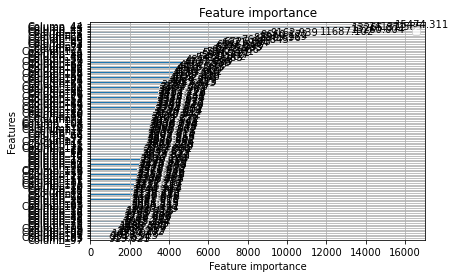

[500]	training's MSE_Modified_1: 0.186848	valid_1's MSE_Modified_1: 0.234602


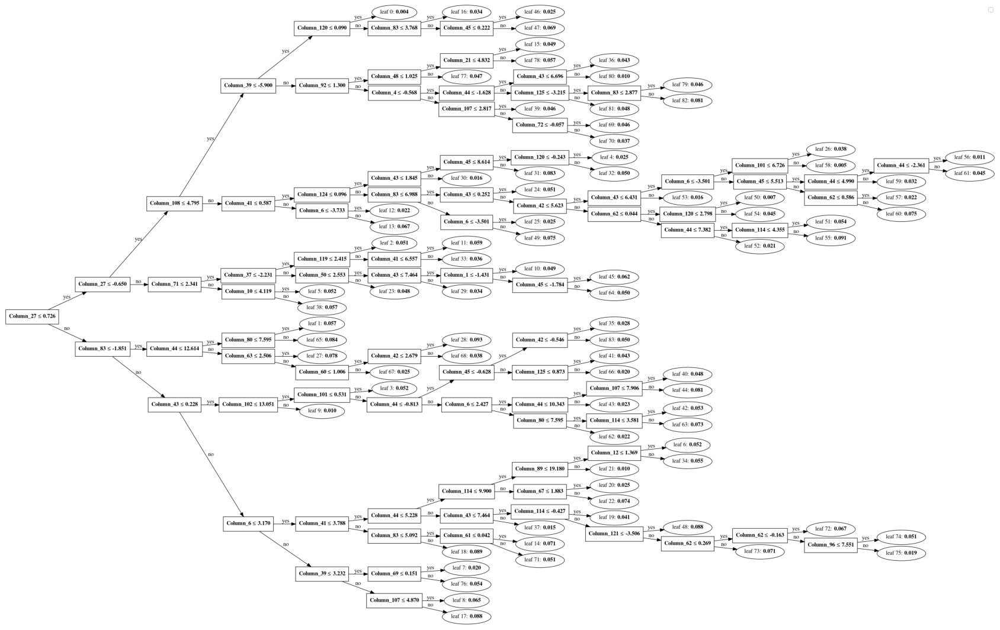

None
[950]	training's MSE_Modified_1: 0.188226	valid_1's MSE_Modified_1: 0.234033
Early stopping, best iteration is:
[914]	training's MSE_Modified_1: 0.189815	valid_1's MSE_Modified_1: 0.233989


<Figure size 432x288 with 0 Axes>

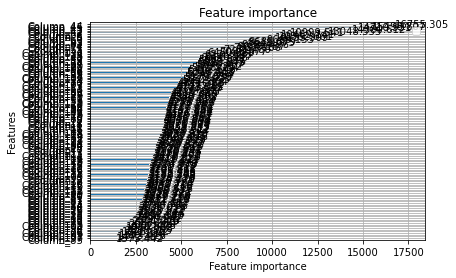

[700]	training's MSE_Modified_1: 0.182643	valid_1's MSE_Modified_1: 0.230733


[I 2021-01-02 14:12:50,802] Trial 0 finished with value: 0.4999359773732052 and parameters: {'lambda_l1': 0.4910295650793526, 'lambda_l2': 0.5867756137415089, 'num_leaves': 84, 'feature_fraction': 0.8713504067764809, 'bagging_fraction': 0.4839900227892329, 'bagging_freq': 5, 'min_child_samples': 40}. Best is trial 0 with value: 0.4999359773732052.


Utility Score = 0.4999359773732052


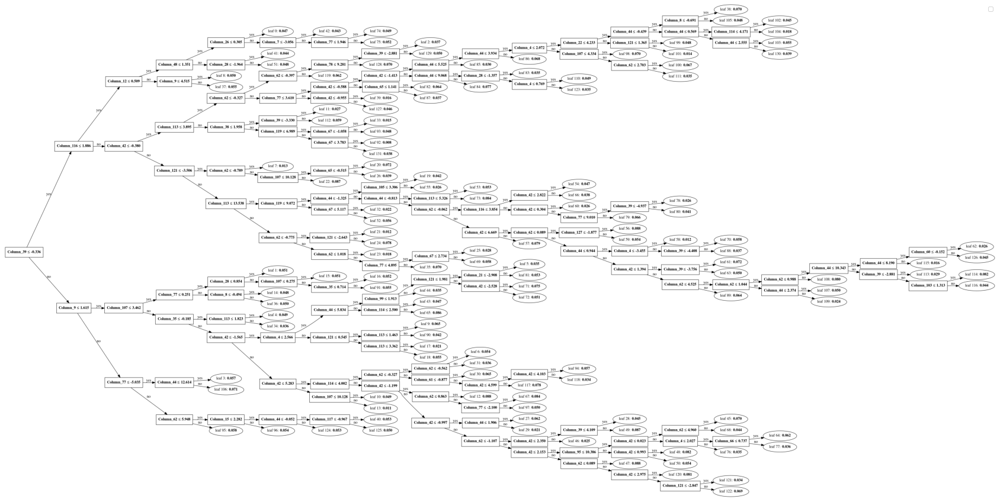

None
[550]	training's MSE_Modified_1: 0.182577	valid_1's MSE_Modified_1: 0.234435
Training until validation scores don't improve for 50 rounds
[750]	training's MSE_Modified_1: 0.179534	valid_1's MSE_Modified_1: 0.230622
[50]	training's MSE_Modified_1: 0.246836	valid_1's MSE_Modified_1: 0.247243


[I 2021-01-02 14:14:36,984] Trial 3 finished with value: 0.5002709134798852 and parameters: {'lambda_l1': 0.8692134689244645, 'lambda_l2': 0.2294747859305905, 'num_leaves': 132, 'feature_fraction': 0.5277532874177702, 'bagging_fraction': 0.5459722653238841, 'bagging_freq': 4, 'min_child_samples': 80}. Best is trial 0 with value: 0.4999359773732052.


Utility Score = 0.5002709134798852
[100]	training's MSE_Modified_1: 0.245166	valid_1's MSE_Modified_1: 0.245901
Training until validation scores don't improve for 50 rounds
[600]	training's MSE_Modified_1: 0.178363	valid_1's MSE_Modified_1: 0.234254
[800]	training's MSE_Modified_1: 0.176416	valid_1's MSE_Modified_1: 0.230469
[150]	training's MSE_Modified_1: 0.243748	valid_1's MSE_Modified_1: 0.244841
[200]	training's MSE_Modified_1: 0.242617	valid_1's MSE_Modified_1: 0.244081
[850]	training's MSE_Modified_1: 0.173308	valid_1's MSE_Modified_1: 0.230152
[50]	training's MSE_Modified_1: 0.237568	valid_1's MSE_Modified_1: 0.241714
[650]	training's MSE_Modified_1: 0.174515	valid_1's MSE_Modified_1: 0.234343
Early stopping, best iteration is:
[600]	training's MSE_Modified_1: 0.178363	valid_1's MSE_Modified_1: 0.234254


<Figure size 432x288 with 0 Axes>

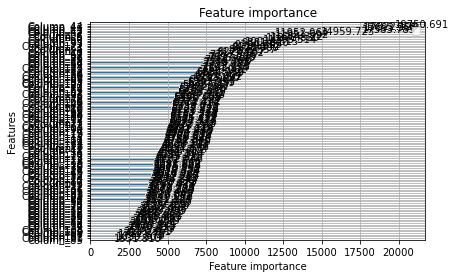

[250]	training's MSE_Modified_1: 0.241538	valid_1's MSE_Modified_1: 0.243367
[300]	training's MSE_Modified_1: 0.240541	valid_1's MSE_Modified_1: 0.242738
[900]	training's MSE_Modified_1: 0.170284	valid_1's MSE_Modified_1: 0.229963


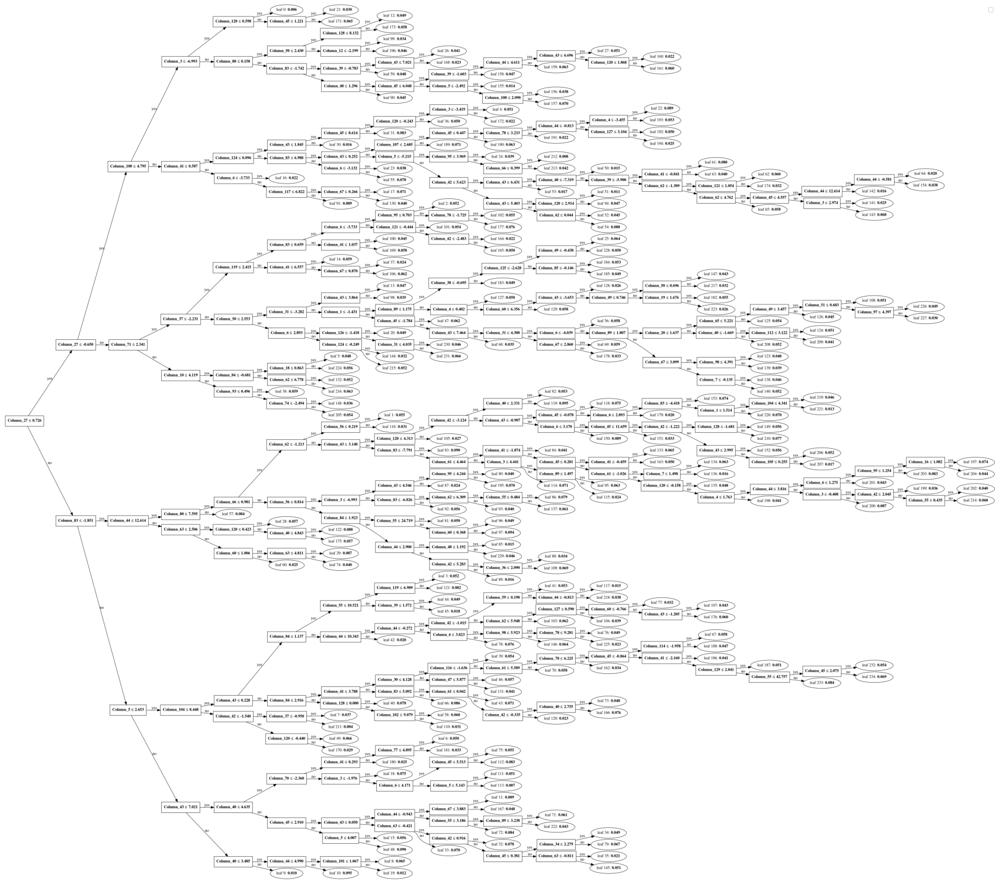

None
[100]	training's MSE_Modified_1: 0.231593	valid_1's MSE_Modified_1: 0.239799
[350]	training's MSE_Modified_1: 0.239492	valid_1's MSE_Modified_1: 0.24204


[I 2021-01-02 14:19:40,882] Trial 2 finished with value: 0.4999208390181011 and parameters: {'lambda_l1': 0.19855609171566416, 'lambda_l2': 0.7190616901035551, 'num_leaves': 235, 'feature_fraction': 0.9755793684947063, 'bagging_fraction': 0.4840682913408959, 'bagging_freq': 1, 'min_child_samples': 57}. Best is trial 2 with value: 0.4999208390181011.


Utility Score = 0.4999208390181011
[400]	training's MSE_Modified_1: 0.238617	valid_1's MSE_Modified_1: 0.24151
[950]	training's MSE_Modified_1: 0.167403	valid_1's MSE_Modified_1: 0.229936
[150]	training's MSE_Modified_1: 0.226491	valid_1's MSE_Modified_1: 0.238742
Training until validation scores don't improve for 50 rounds
[450]	training's MSE_Modified_1: 0.237808	valid_1's MSE_Modified_1: 0.241074
[50]	training's MSE_Modified_1: 0.248392	valid_1's MSE_Modified_1: 0.248567
[1000]	training's MSE_Modified_1: 0.164408	valid_1's MSE_Modified_1: 0.229587
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.164408	valid_1's MSE_Modified_1: 0.229587
[500]	training's MSE_Modified_1: 0.236995	valid_1's MSE_Modified_1: 0.240643


<Figure size 432x288 with 0 Axes>

[100]	training's MSE_Modified_1: 0.247621	valid_1's MSE_Modified_1: 0.24792
[200]	training's MSE_Modified_1: 0.221717	valid_1's MSE_Modified_1: 0.238042


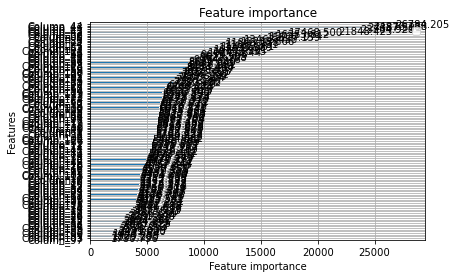

[550]	training's MSE_Modified_1: 0.236202	valid_1's MSE_Modified_1: 0.240202
[150]	training's MSE_Modified_1: 0.247018	valid_1's MSE_Modified_1: 0.24745


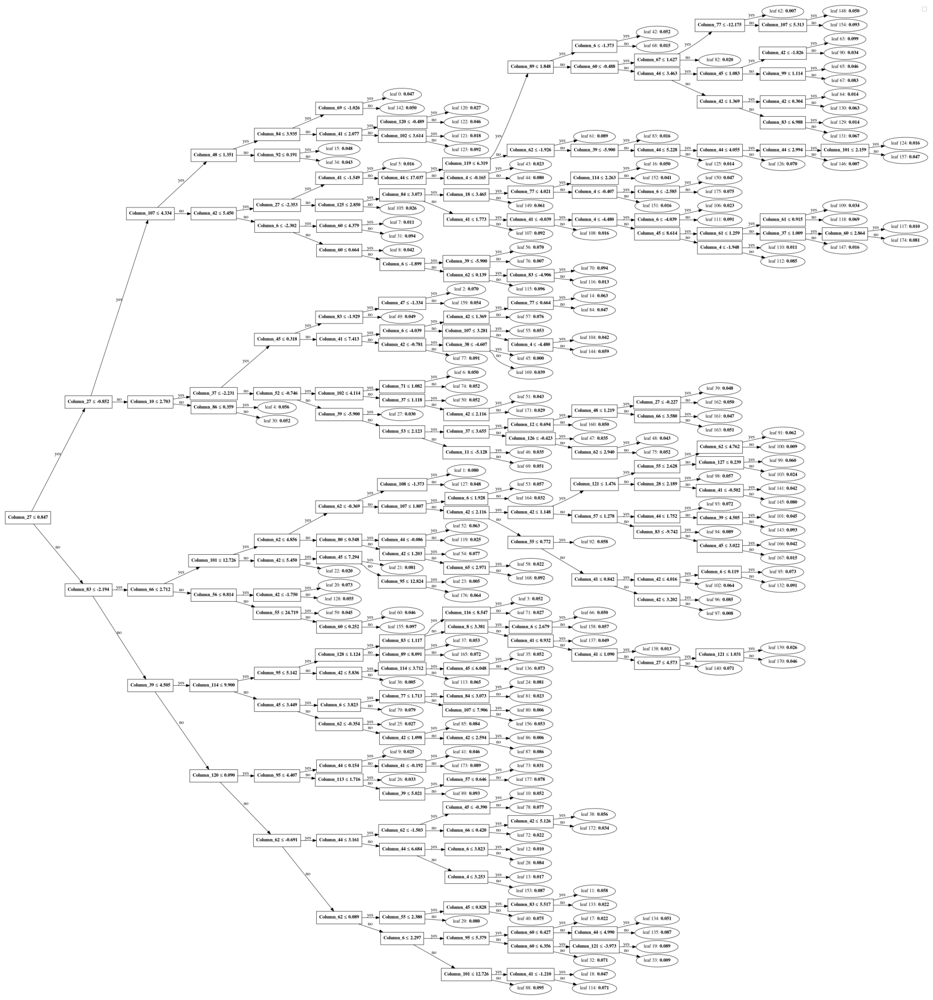

None
[200]	training's MSE_Modified_1: 0.246448	valid_1's MSE_Modified_1: 0.246995
[600]	training's MSE_Modified_1: 0.23544	valid_1's MSE_Modified_1: 0.239836
[250]	training's MSE_Modified_1: 0.217399	valid_1's MSE_Modified_1: 0.237513
[250]	training's MSE_Modified_1: 0.245932	valid_1's MSE_Modified_1: 0.246606
[650]	training's MSE_Modified_1: 0.234707	valid_1's MSE_Modified_1: 0.239502
[300]	training's MSE_Modified_1: 0.245364	valid_1's MSE_Modified_1: 0.246176


[I 2021-01-02 14:23:58,186] Trial 1 finished with value: 0.5002810057166214 and parameters: {'lambda_l1': 0.16884233805141116, 'lambda_l2': 0.11512143392482144, 'num_leaves': 178, 'feature_fraction': 0.8381003309101716, 'bagging_fraction': 0.6416595564810516, 'bagging_freq': 3, 'min_child_samples': 12}. Best is trial 2 with value: 0.4999208390181011.


Utility Score = 0.5002810057166214
[700]	training's MSE_Modified_1: 0.234063	valid_1's MSE_Modified_1: 0.239269
[350]	training's MSE_Modified_1: 0.244899	valid_1's MSE_Modified_1: 0.245826
Training until validation scores don't improve for 50 rounds
[300]	training's MSE_Modified_1: 0.213115	valid_1's MSE_Modified_1: 0.236974
[400]	training's MSE_Modified_1: 0.244474	valid_1's MSE_Modified_1: 0.245508
[750]	training's MSE_Modified_1: 0.233383	valid_1's MSE_Modified_1: 0.238966
[450]	training's MSE_Modified_1: 0.244131	valid_1's MSE_Modified_1: 0.245321
[800]	training's MSE_Modified_1: 0.232741	valid_1's MSE_Modified_1: 0.238712
[50]	training's MSE_Modified_1: 0.240829	valid_1's MSE_Modified_1: 0.243311
[350]	training's MSE_Modified_1: 0.209161	valid_1's MSE_Modified_1: 0.236591
[500]	training's MSE_Modified_1: 0.243788	valid_1's MSE_Modified_1: 0.245112
[850]	training's MSE_Modified_1: 0.23211	valid_1's MSE_Modified_1: 0.23846
[550]	training's MSE_Modified_1: 0.243403	valid_1's MSE_Modi

<Figure size 432x288 with 0 Axes>

[750]	training's MSE_Modified_1: 0.242171	valid_1's MSE_Modified_1: 0.244097


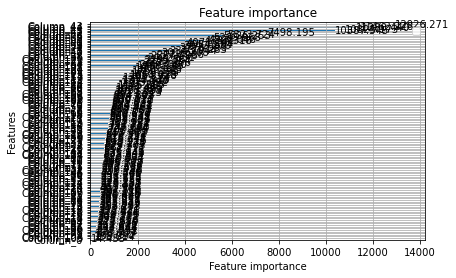

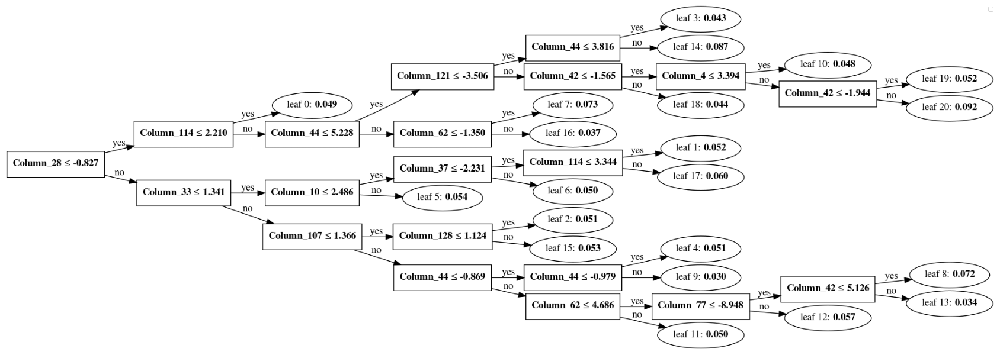

None
[800]	training's MSE_Modified_1: 0.24185	valid_1's MSE_Modified_1: 0.243911
[200]	training's MSE_Modified_1: 0.228854	valid_1's MSE_Modified_1: 0.238868


[I 2021-01-02 14:30:09,324] Trial 4 finished with value: 0.5003453437258141 and parameters: {'lambda_l1': 0.39167398447669216, 'lambda_l2': 0.1713561901611104, 'num_leaves': 21, 'feature_fraction': 0.6162832925170327, 'bagging_fraction': 0.8719002664834693, 'bagging_freq': 2, 'min_child_samples': 10}. Best is trial 2 with value: 0.4999208390181011.


Utility Score = 0.5003453437258141
[850]	training's MSE_Modified_1: 0.241574	valid_1's MSE_Modified_1: 0.243771
[500]	training's MSE_Modified_1: 0.197808	valid_1's MSE_Modified_1: 0.235907
Training until validation scores don't improve for 50 rounds
[900]	training's MSE_Modified_1: 0.241303	valid_1's MSE_Modified_1: 0.243628
[250]	training's MSE_Modified_1: 0.225877	valid_1's MSE_Modified_1: 0.238324
[950]	training's MSE_Modified_1: 0.240991	valid_1's MSE_Modified_1: 0.243441
[1000]	training's MSE_Modified_1: 0.240696	valid_1's MSE_Modified_1: 0.243287
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.240696	valid_1's MSE_Modified_1: 0.243287


<Figure size 432x288 with 0 Axes>

[550]	training's MSE_Modified_1: 0.194309	valid_1's MSE_Modified_1: 0.235777
[300]	training's MSE_Modified_1: 0.222877	valid_1's MSE_Modified_1: 0.237669


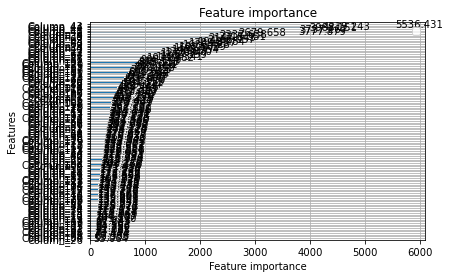

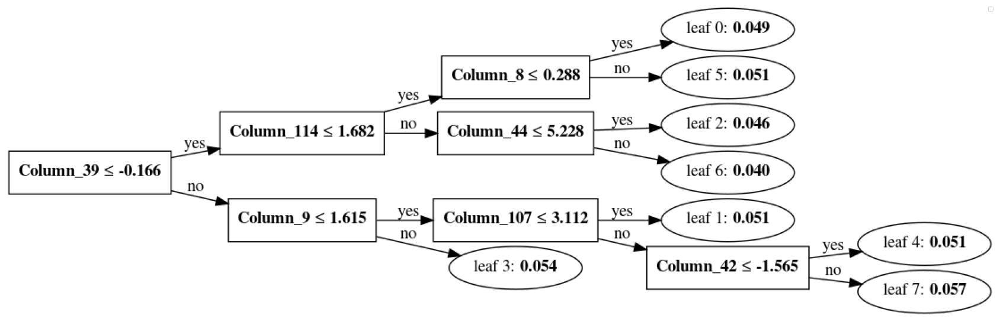

None
[50]	training's MSE_Modified_1: 0.238769	valid_1's MSE_Modified_1: 0.242371


[I 2021-01-02 14:32:56,051] Trial 6 finished with value: 0.5000760071579189 and parameters: {'lambda_l1': 0.32567273525282975, 'lambda_l2': 0.2495560582493677, 'num_leaves': 8, 'feature_fraction': 0.6406360795196986, 'bagging_fraction': 0.6546697442834415, 'bagging_freq': 3, 'min_child_samples': 73}. Best is trial 2 with value: 0.4999208390181011.


Utility Score = 0.5000760071579189
[350]	training's MSE_Modified_1: 0.220093	valid_1's MSE_Modified_1: 0.237222
[600]	training's MSE_Modified_1: 0.19089	valid_1's MSE_Modified_1: 0.2356
Training until validation scores don't improve for 50 rounds
[100]	training's MSE_Modified_1: 0.232801	valid_1's MSE_Modified_1: 0.240019
[400]	training's MSE_Modified_1: 0.217423	valid_1's MSE_Modified_1: 0.23688
[50]	training's MSE_Modified_1: 0.244865	valid_1's MSE_Modified_1: 0.245675
[650]	training's MSE_Modified_1: 0.187593	valid_1's MSE_Modified_1: 0.235378
[150]	training's MSE_Modified_1: 0.228096	valid_1's MSE_Modified_1: 0.238899
[450]	training's MSE_Modified_1: 0.21481	valid_1's MSE_Modified_1: 0.236614
[100]	training's MSE_Modified_1: 0.242235	valid_1's MSE_Modified_1: 0.243773
[700]	training's MSE_Modified_1: 0.184237	valid_1's MSE_Modified_1: 0.235127
[200]	training's MSE_Modified_1: 0.223292	valid_1's MSE_Modified_1: 0.237545
[500]	training's MSE_Modified_1: 0.212257	valid_1's MSE_Modifie

<Figure size 432x288 with 0 Axes>

[300]	training's MSE_Modified_1: 0.234882	valid_1's MSE_Modified_1: 0.239495


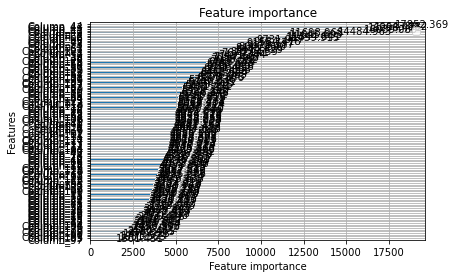

[350]	training's MSE_Modified_1: 0.211782	valid_1's MSE_Modified_1: 0.236122
[650]	training's MSE_Modified_1: 0.204993	valid_1's MSE_Modified_1: 0.235752
[350]	training's MSE_Modified_1: 0.233246	valid_1's MSE_Modified_1: 0.238613


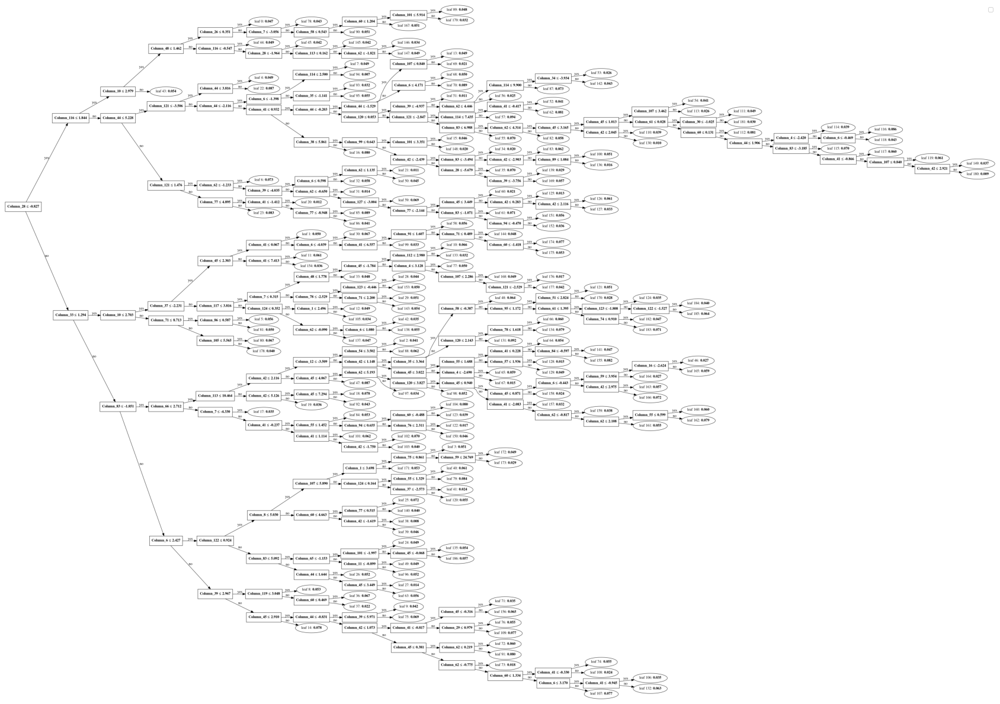

None
[700]	training's MSE_Modified_1: 0.202716	valid_1's MSE_Modified_1: 0.235658
[400]	training's MSE_Modified_1: 0.20835	valid_1's MSE_Modified_1: 0.235986
[400]	training's MSE_Modified_1: 0.231873	valid_1's MSE_Modified_1: 0.238092


[I 2021-01-02 14:41:49,066] Trial 5 finished with value: 0.500414097088579 and parameters: {'lambda_l1': 0.22440059357975092, 'lambda_l2': 0.738873511368044, 'num_leaves': 187, 'feature_fraction': 0.7939016654694324, 'bagging_fraction': 0.4483179709515318, 'bagging_freq': 6, 'min_child_samples': 46}. Best is trial 2 with value: 0.4999208390181011.


Utility Score = 0.500414097088579
[450]	training's MSE_Modified_1: 0.230528	valid_1's MSE_Modified_1: 0.237533
[750]	training's MSE_Modified_1: 0.200483	valid_1's MSE_Modified_1: 0.235561
Training until validation scores don't improve for 50 rounds
[450]	training's MSE_Modified_1: 0.204832	valid_1's MSE_Modified_1: 0.23573
[500]	training's MSE_Modified_1: 0.229305	valid_1's MSE_Modified_1: 0.237113
[50]	training's MSE_Modified_1: 0.245962	valid_1's MSE_Modified_1: 0.246567
[800]	training's MSE_Modified_1: 0.19819	valid_1's MSE_Modified_1: 0.235416
[550]	training's MSE_Modified_1: 0.228055	valid_1's MSE_Modified_1: 0.23665
[500]	training's MSE_Modified_1: 0.201366	valid_1's MSE_Modified_1: 0.235352
[100]	training's MSE_Modified_1: 0.243817	valid_1's MSE_Modified_1: 0.245008
[850]	training's MSE_Modified_1: 0.19596	valid_1's MSE_Modified_1: 0.2353
[600]	training's MSE_Modified_1: 0.226712	valid_1's MSE_Modified_1: 0.236058
[150]	training's MSE_Modified_1: 0.242112	valid_1's MSE_Modified_

<Figure size 432x288 with 0 Axes>

[800]	training's MSE_Modified_1: 0.222054	valid_1's MSE_Modified_1: 0.234551


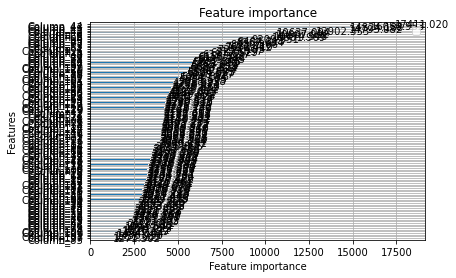

[700]	training's MSE_Modified_1: 0.189198	valid_1's MSE_Modified_1: 0.234842
[450]	training's MSE_Modified_1: 0.234684	valid_1's MSE_Modified_1: 0.239821


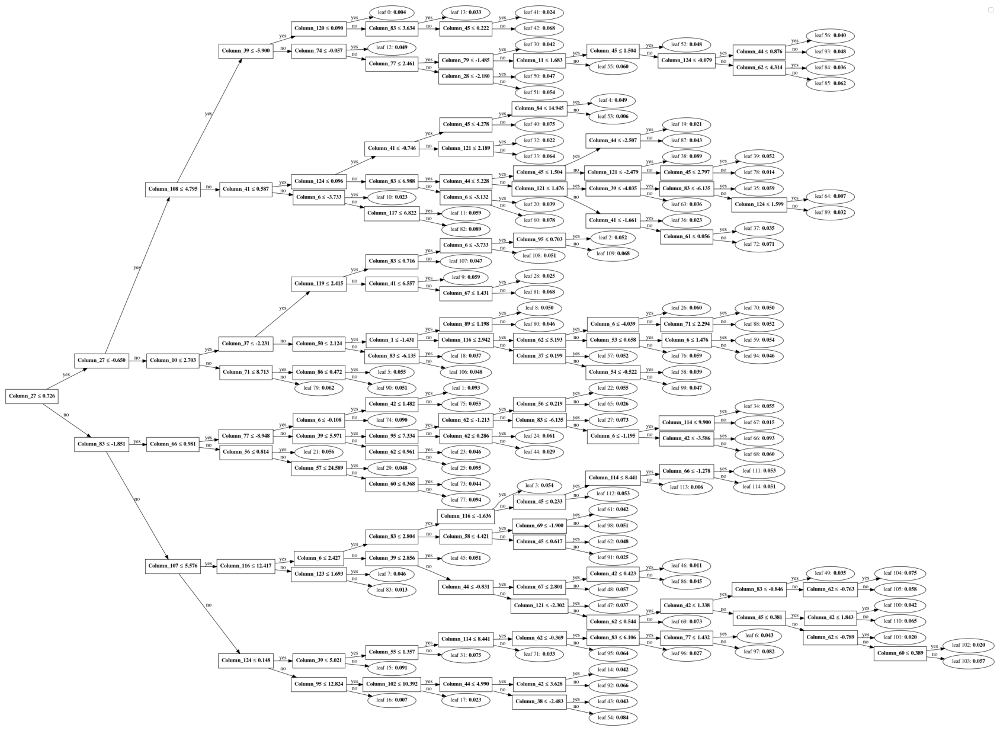

None
[850]	training's MSE_Modified_1: 0.220953	valid_1's MSE_Modified_1: 0.234254
[500]	training's MSE_Modified_1: 0.233713	valid_1's MSE_Modified_1: 0.239425
[750]	training's MSE_Modified_1: 0.186135	valid_1's MSE_Modified_1: 0.234582
[900]	training's MSE_Modified_1: 0.219957	valid_1's MSE_Modified_1: 0.234016
[550]	training's MSE_Modified_1: 0.232687	valid_1's MSE_Modified_1: 0.238982


[I 2021-01-02 14:50:36,699] Trial 7 finished with value: 0.49939036582465873 and parameters: {'lambda_l1': 0.33660114209853526, 'lambda_l2': 0.24392877588650577, 'num_leaves': 115, 'feature_fraction': 0.8027880833149212, 'bagging_fraction': 0.47798872083390387, 'bagging_freq': 6, 'min_child_samples': 46}. Best is trial 7 with value: 0.49939036582465873.


Utility Score = 0.49939036582465873
[600]	training's MSE_Modified_1: 0.231589	valid_1's MSE_Modified_1: 0.238413
[800]	training's MSE_Modified_1: 0.183363	valid_1's MSE_Modified_1: 0.234572
[950]	training's MSE_Modified_1: 0.218941	valid_1's MSE_Modified_1: 0.233749
Training until validation scores don't improve for 50 rounds
[650]	training's MSE_Modified_1: 0.230564	valid_1's MSE_Modified_1: 0.237954
[1000]	training's MSE_Modified_1: 0.217836	valid_1's MSE_Modified_1: 0.233388
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.217836	valid_1's MSE_Modified_1: 0.233388


<Figure size 432x288 with 0 Axes>

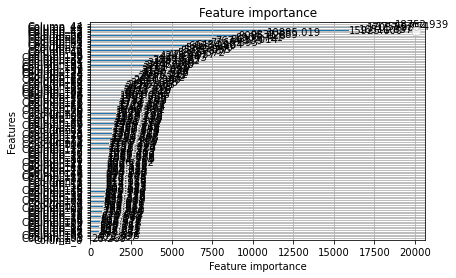

[700]	training's MSE_Modified_1: 0.229639	valid_1's MSE_Modified_1: 0.237635
[850]	training's MSE_Modified_1: 0.180525	valid_1's MSE_Modified_1: 0.234549


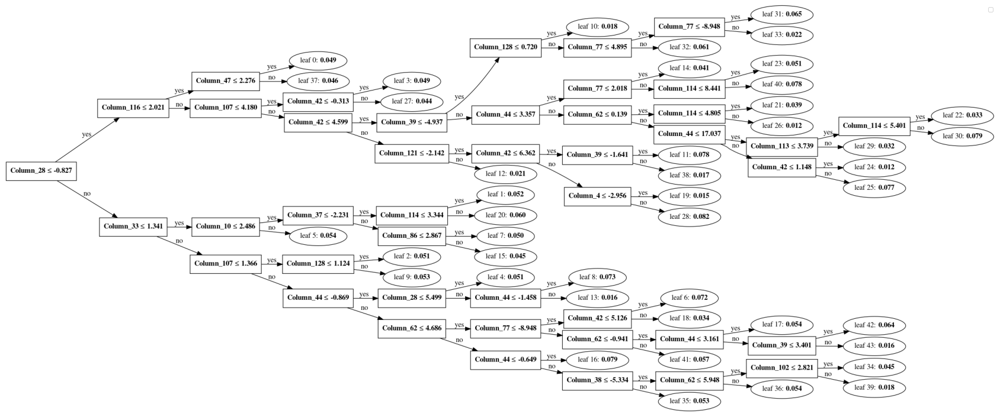

None
[750]	training's MSE_Modified_1: 0.228878	valid_1's MSE_Modified_1: 0.237459


[I 2021-01-02 14:53:03,756] Trial 9 finished with value: 0.49984388571298816 and parameters: {'lambda_l1': 0.5839888455175565, 'lambda_l2': 0.27307529452101104, 'num_leaves': 44, 'feature_fraction': 0.5411900483807834, 'bagging_fraction': 0.9681829630610422, 'bagging_freq': 2, 'min_child_samples': 13}. Best is trial 7 with value: 0.49939036582465873.


Utility Score = 0.49984388571298816
[50]	training's MSE_Modified_1: 0.239527	valid_1's MSE_Modified_1: 0.242268
[900]	training's MSE_Modified_1: 0.177665	valid_1's MSE_Modified_1: 0.234336
[800]	training's MSE_Modified_1: 0.228017	valid_1's MSE_Modified_1: 0.237136
Training until validation scores don't improve for 50 rounds
[850]	training's MSE_Modified_1: 0.227203	valid_1's MSE_Modified_1: 0.23696
[950]	training's MSE_Modified_1: 0.174845	valid_1's MSE_Modified_1: 0.234265
[900]	training's MSE_Modified_1: 0.2264	valid_1's MSE_Modified_1: 0.23673
[100]	training's MSE_Modified_1: 0.234104	valid_1's MSE_Modified_1: 0.239581
[950]	training's MSE_Modified_1: 0.225642	valid_1's MSE_Modified_1: 0.236561
[50]	training's MSE_Modified_1: 0.240178	valid_1's MSE_Modified_1: 0.243046
[1000]	training's MSE_Modified_1: 0.17215	valid_1's MSE_Modified_1: 0.234219
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.17215	valid_1's MSE_Modified_1: 0.234219


<Figure size 432x288 with 0 Axes>

[1000]	training's MSE_Modified_1: 0.224845	valid_1's MSE_Modified_1: 0.236365
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.224845	valid_1's MSE_Modified_1: 0.236365


<Figure size 432x288 with 0 Axes>

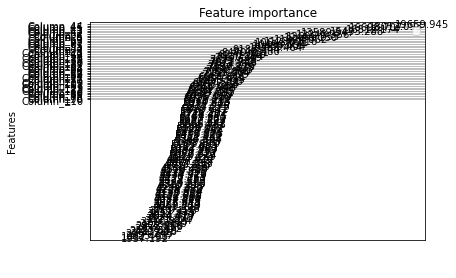

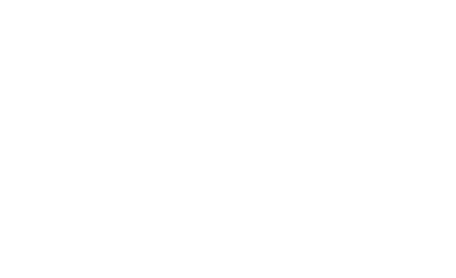

<Figure size 432x288 with 0 Axes>

[150]	training's MSE_Modified_1: 0.229595	valid_1's MSE_Modified_1: 0.237768


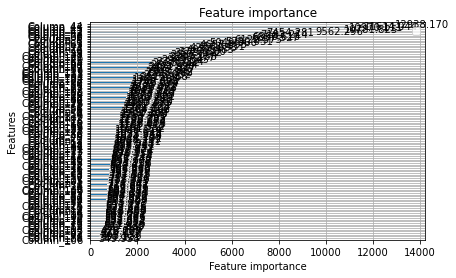

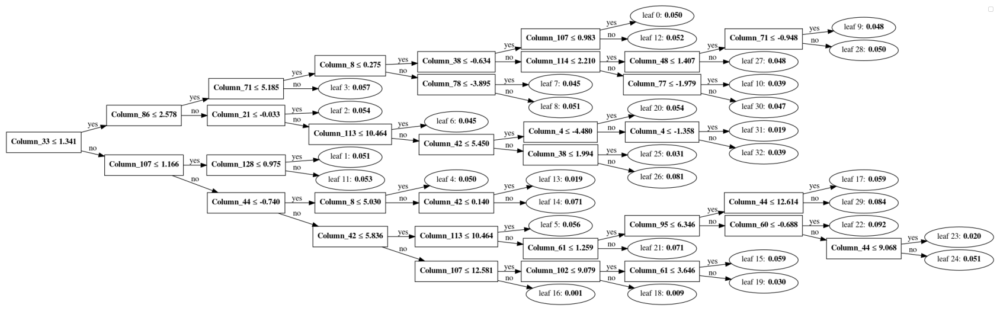

None


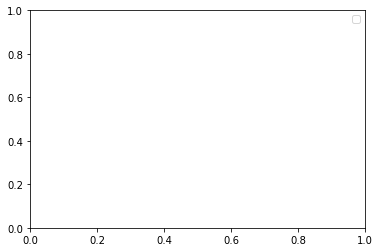

None
[100]	training's MSE_Modified_1: 0.23505	valid_1's MSE_Modified_1: 0.240772


[I 2021-01-02 14:57:03,285] Trial 10 finished with value: 0.5002614520079451 and parameters: {'lambda_l1': 0.44338038397874113, 'lambda_l2': 0.11593292229807593, 'num_leaves': 33, 'feature_fraction': 0.41867102062994627, 'bagging_fraction': 0.8380692078612186, 'bagging_freq': 7, 'min_child_samples': 70}. Best is trial 7 with value: 0.49939036582465873.


Utility Score = 0.5002614520079451
Training until validation scores don't improve for 50 rounds
[200]	training's MSE_Modified_1: 0.225812	valid_1's MSE_Modified_1: 0.236828
[150]	training's MSE_Modified_1: 0.23104	valid_1's MSE_Modified_1: 0.239682


[I 2021-01-02 14:58:18,992] Trial 8 finished with value: 0.4997316095792988 and parameters: {'lambda_l1': 0.20359137601096167, 'lambda_l2': 0.13527941441498095, 'num_leaves': 174, 'feature_fraction': 0.5234234861468786, 'bagging_fraction': 0.5198350924078026, 'bagging_freq': 4, 'min_child_samples': 48}. Best is trial 7 with value: 0.49939036582465873.


Utility Score = 0.4997316095792988
[200]	training's MSE_Modified_1: 0.227416	valid_1's MSE_Modified_1: 0.23893
Training until validation scores don't improve for 50 rounds
[250]	training's MSE_Modified_1: 0.22226	valid_1's MSE_Modified_1: 0.236015
[50]	training's MSE_Modified_1: 0.241067	valid_1's MSE_Modified_1: 0.243039
[250]	training's MSE_Modified_1: 0.223824	valid_1's MSE_Modified_1: 0.238174
[50]	training's MSE_Modified_1: 0.240285	valid_1's MSE_Modified_1: 0.242886
[300]	training's MSE_Modified_1: 0.218597	valid_1's MSE_Modified_1: 0.234933
[300]	training's MSE_Modified_1: 0.220544	valid_1's MSE_Modified_1: 0.237724
[100]	training's MSE_Modified_1: 0.236115	valid_1's MSE_Modified_1: 0.240008
[100]	training's MSE_Modified_1: 0.235473	valid_1's MSE_Modified_1: 0.240768
[350]	training's MSE_Modified_1: 0.215533	valid_1's MSE_Modified_1: 0.234555
[350]	training's MSE_Modified_1: 0.217304	valid_1's MSE_Modified_1: 0.23713
[150]	training's MSE_Modified_1: 0.232833	valid_1's MSE_Modifi

<Figure size 432x288 with 0 Axes>

[350]	training's MSE_Modified_1: 0.217697	valid_1's MSE_Modified_1: 0.235847


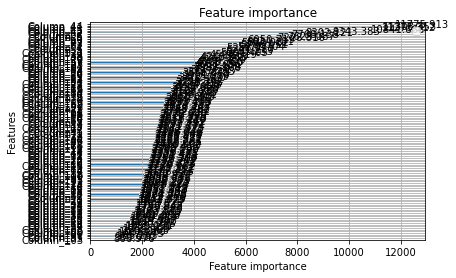

[350]	training's MSE_Modified_1: 0.220984	valid_1's MSE_Modified_1: 0.235048


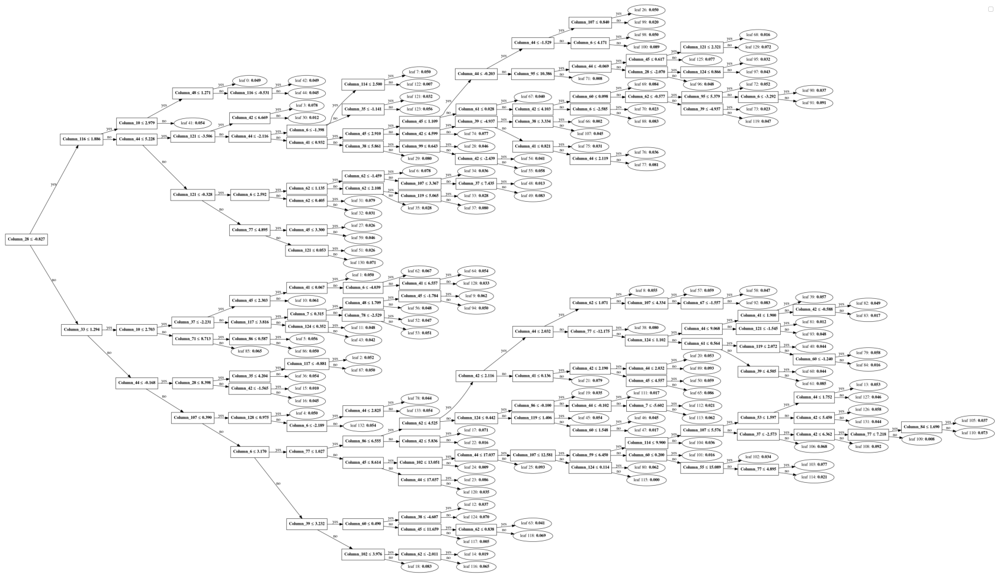

None
[600]	training's MSE_Modified_1: 0.201054	valid_1's MSE_Modified_1: 0.232507
[400]	training's MSE_Modified_1: 0.214736	valid_1's MSE_Modified_1: 0.23542


[I 2021-01-02 15:08:58,807] Trial 12 finished with value: 0.4998237012395159 and parameters: {'lambda_l1': 0.19068660323907333, 'lambda_l2': 0.6678795661882113, 'num_leaves': 134, 'feature_fraction': 0.6852746705868678, 'bagging_fraction': 0.453183949270838, 'bagging_freq': 7, 'min_child_samples': 18}. Best is trial 7 with value: 0.49939036582465873.


Utility Score = 0.4998237012395159
[400]	training's MSE_Modified_1: 0.218426	valid_1's MSE_Modified_1: 0.234362
Training until validation scores don't improve for 50 rounds
[450]	training's MSE_Modified_1: 0.21175	valid_1's MSE_Modified_1: 0.234865
[650]	training's MSE_Modified_1: 0.198383	valid_1's MSE_Modified_1: 0.232251
[450]	training's MSE_Modified_1: 0.216041	valid_1's MSE_Modified_1: 0.233999
[50]	training's MSE_Modified_1: 0.238725	valid_1's MSE_Modified_1: 0.242312
[500]	training's MSE_Modified_1: 0.208881	valid_1's MSE_Modified_1: 0.234455
[700]	training's MSE_Modified_1: 0.195764	valid_1's MSE_Modified_1: 0.231946
[500]	training's MSE_Modified_1: 0.213647	valid_1's MSE_Modified_1: 0.233547
[550]	training's MSE_Modified_1: 0.206256	valid_1's MSE_Modified_1: 0.234188
[100]	training's MSE_Modified_1: 0.232676	valid_1's MSE_Modified_1: 0.23989
[750]	training's MSE_Modified_1: 0.19328	valid_1's MSE_Modified_1: 0.231769
[600]	training's MSE_Modified_1: 0.203501	valid_1's MSE_Modif

<Figure size 432x288 with 0 Axes>

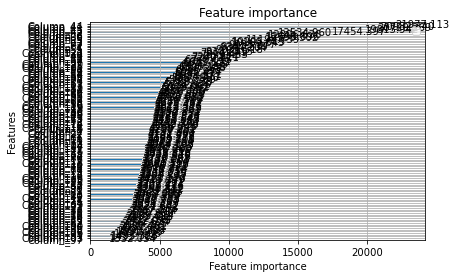

[400]	training's MSE_Modified_1: 0.20823	valid_1's MSE_Modified_1: 0.235551
[800]	training's MSE_Modified_1: 0.200295	valid_1's MSE_Modified_1: 0.231268


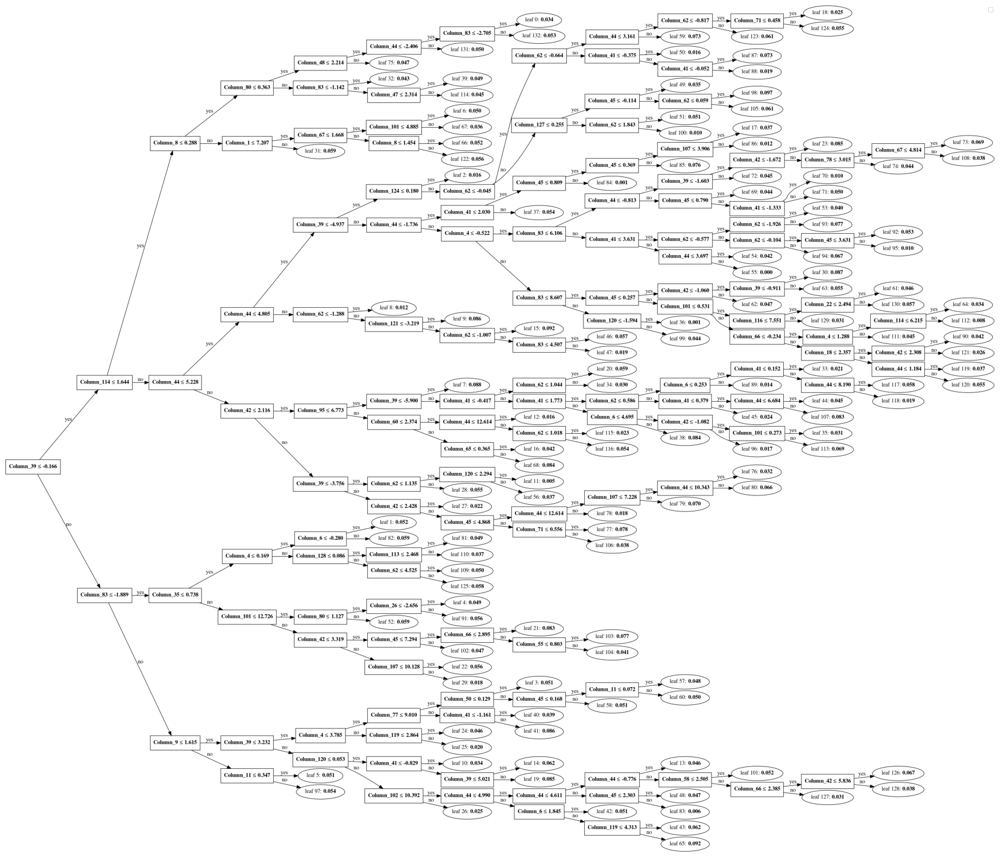

None
[900]	training's MSE_Modified_1: 0.189211	valid_1's MSE_Modified_1: 0.232564
[450]	training's MSE_Modified_1: 0.204774	valid_1's MSE_Modified_1: 0.235156
[950]	training's MSE_Modified_1: 0.187001	valid_1's MSE_Modified_1: 0.232474
[850]	training's MSE_Modified_1: 0.198219	valid_1's MSE_Modified_1: 0.230947


[I 2021-01-02 15:21:40,849] Trial 11 finished with value: 0.4997316095792988 and parameters: {'lambda_l1': 0.8836493626112663, 'lambda_l2': 0.22027191206976754, 'num_leaves': 133, 'feature_fraction': 0.7813976882142015, 'bagging_fraction': 0.6094994966576193, 'bagging_freq': 2, 'min_child_samples': 64}. Best is trial 7 with value: 0.49939036582465873.


Utility Score = 0.4997316095792988
[500]	training's MSE_Modified_1: 0.20132	valid_1's MSE_Modified_1: 0.23474
[1000]	training's MSE_Modified_1: 0.184678	valid_1's MSE_Modified_1: 0.232302
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.184678	valid_1's MSE_Modified_1: 0.232302
Training until validation scores don't improve for 50 rounds


<Figure size 432x288 with 0 Axes>

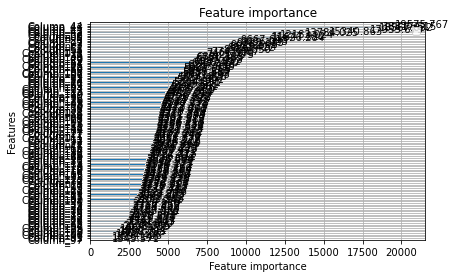

[900]	training's MSE_Modified_1: 0.196301	valid_1's MSE_Modified_1: 0.230853


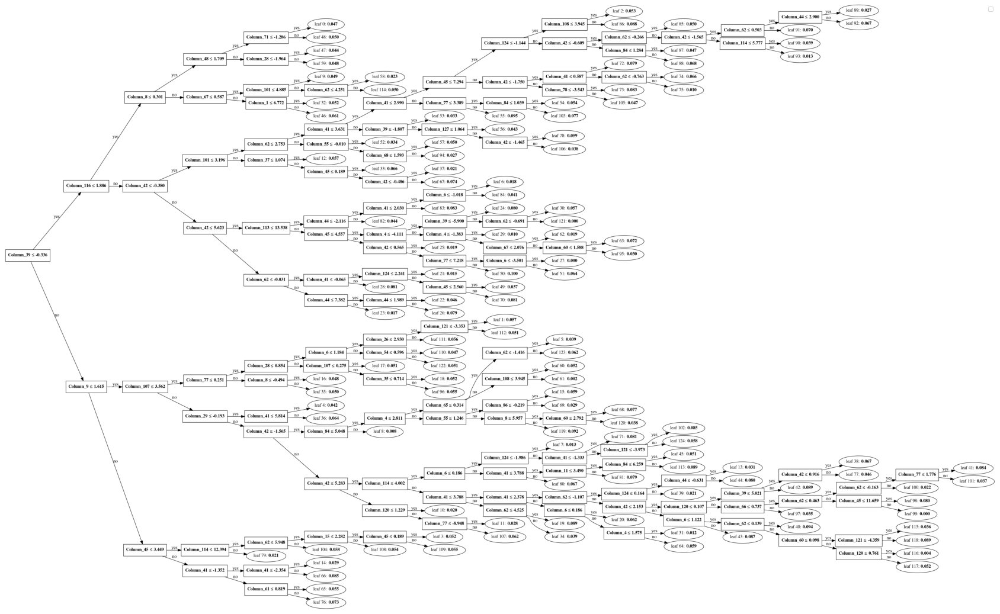

None
[550]	training's MSE_Modified_1: 0.198052	valid_1's MSE_Modified_1: 0.234574
[950]	training's MSE_Modified_1: 0.194391	valid_1's MSE_Modified_1: 0.230631
[50]	training's MSE_Modified_1: 0.237609	valid_1's MSE_Modified_1: 0.241144
[600]	training's MSE_Modified_1: 0.194928	valid_1's MSE_Modified_1: 0.23448


[I 2021-01-02 15:24:43,022] Trial 14 finished with value: 0.5000387920349545 and parameters: {'lambda_l1': 0.1258797569648784, 'lambda_l2': 0.40353878890139194, 'num_leaves': 125, 'feature_fraction': 0.7413912003808484, 'bagging_fraction': 0.571658073136502, 'bagging_freq': 7, 'min_child_samples': 30}. Best is trial 7 with value: 0.49939036582465873.


Utility Score = 0.5000387920349545
[1000]	training's MSE_Modified_1: 0.192431	valid_1's MSE_Modified_1: 0.230347
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.192431	valid_1's MSE_Modified_1: 0.230347


<Figure size 432x288 with 0 Axes>

Training until validation scores don't improve for 50 rounds
[100]	training's MSE_Modified_1: 0.231039	valid_1's MSE_Modified_1: 0.238201


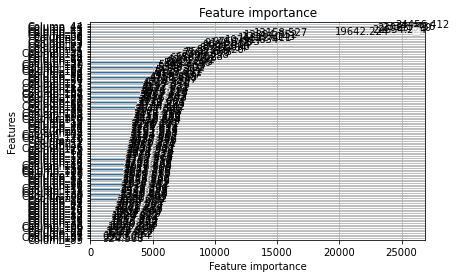

[650]	training's MSE_Modified_1: 0.191863	valid_1's MSE_Modified_1: 0.234263


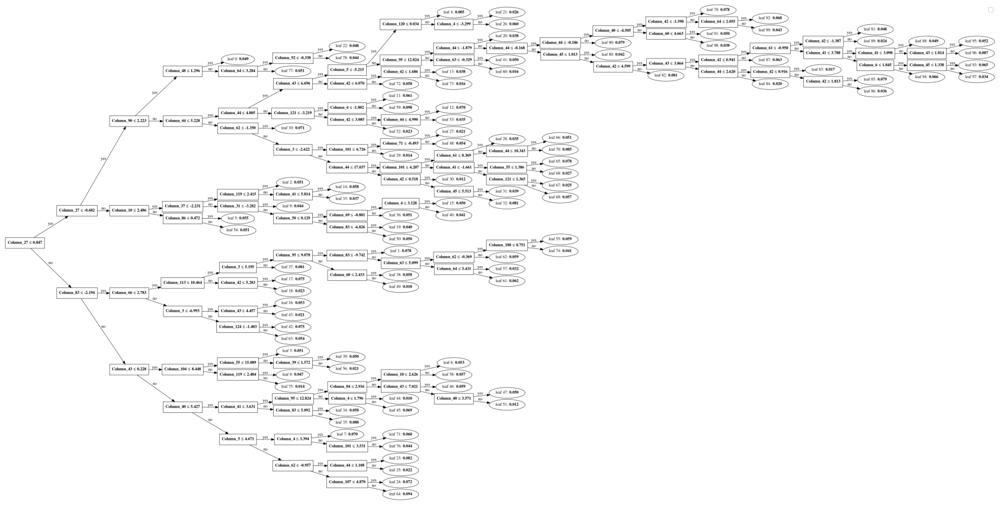

None
[150]	training's MSE_Modified_1: 0.225704	valid_1's MSE_Modified_1: 0.236574
[50]	training's MSE_Modified_1: 0.237623	valid_1's MSE_Modified_1: 0.241162
[700]	training's MSE_Modified_1: 0.18879	valid_1's MSE_Modified_1: 0.234014


[I 2021-01-02 15:27:25,494] Trial 13 finished with value: 0.49995616184667746 and parameters: {'lambda_l1': 0.10633001380076967, 'lambda_l2': 0.41611498530787305, 'num_leaves': 100, 'feature_fraction': 0.9971964693701005, 'bagging_fraction': 0.7414969262664135, 'bagging_freq': 7, 'min_child_samples': 99}. Best is trial 7 with value: 0.49939036582465873.


Utility Score = 0.49995616184667746
[200]	training's MSE_Modified_1: 0.220829	valid_1's MSE_Modified_1: 0.235101
Training until validation scores don't improve for 50 rounds
[750]	training's MSE_Modified_1: 0.185834	valid_1's MSE_Modified_1: 0.233883
[100]	training's MSE_Modified_1: 0.231407	valid_1's MSE_Modified_1: 0.238537
[250]	training's MSE_Modified_1: 0.216635	valid_1's MSE_Modified_1: 0.234294
[800]	training's MSE_Modified_1: 0.183019	valid_1's MSE_Modified_1: 0.233883
Early stopping, best iteration is:
[752]	training's MSE_Modified_1: 0.185694	valid_1's MSE_Modified_1: 0.233862


<Figure size 432x288 with 0 Axes>

[50]	training's MSE_Modified_1: 0.237843	valid_1's MSE_Modified_1: 0.241138
[150]	training's MSE_Modified_1: 0.226072	valid_1's MSE_Modified_1: 0.236756


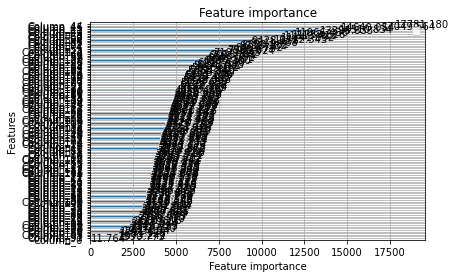

[300]	training's MSE_Modified_1: 0.212306	valid_1's MSE_Modified_1: 0.23342


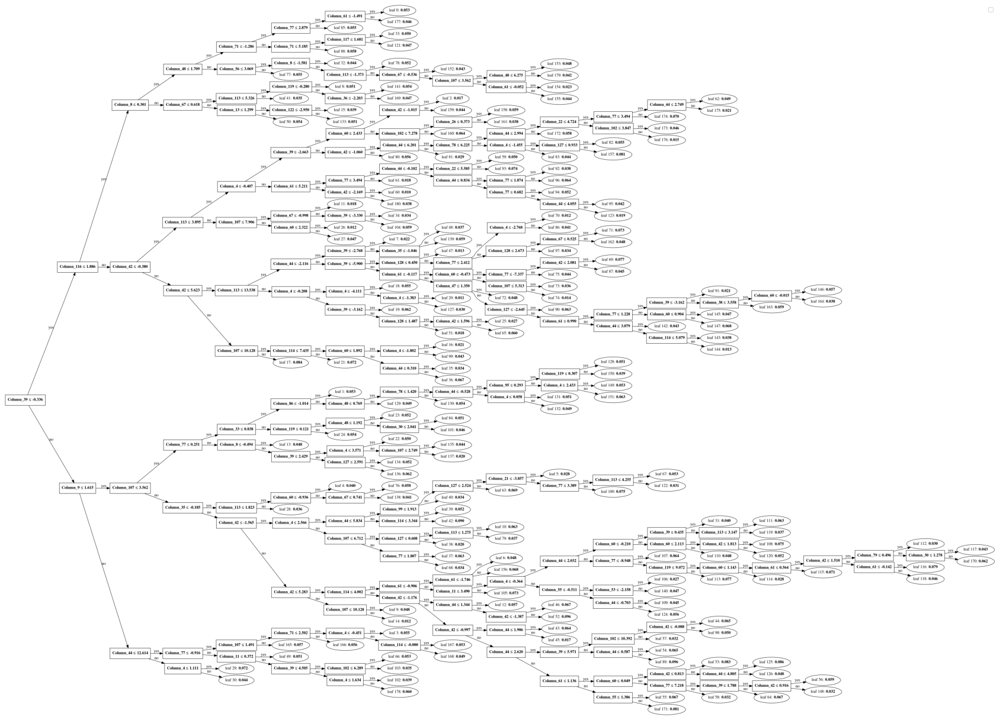

None
[200]	training's MSE_Modified_1: 0.221447	valid_1's MSE_Modified_1: 0.235666
[100]	training's MSE_Modified_1: 0.231349	valid_1's MSE_Modified_1: 0.238158
[350]	training's MSE_Modified_1: 0.208305	valid_1's MSE_Modified_1: 0.232765


[I 2021-01-02 15:32:00,928] Trial 15 finished with value: 0.5002330675921248 and parameters: {'lambda_l1': 0.10233236310762826, 'lambda_l2': 0.41666089580723586, 'num_leaves': 181, 'feature_fraction': 0.4280879649307858, 'bagging_fraction': 0.5795342740387137, 'bagging_freq': 5, 'min_child_samples': 99}. Best is trial 7 with value: 0.49939036582465873.


[150]	training's MSE_Modified_1: 0.226377	valid_1's MSE_Modified_1: 0.23663
Utility Score = 0.5002330675921248
[250]	training's MSE_Modified_1: 0.217212	valid_1's MSE_Modified_1: 0.234715
[400]	training's MSE_Modified_1: 0.204511	valid_1's MSE_Modified_1: 0.232243
Training until validation scores don't improve for 50 rounds
[200]	training's MSE_Modified_1: 0.221935	valid_1's MSE_Modified_1: 0.235651
[300]	training's MSE_Modified_1: 0.213124	valid_1's MSE_Modified_1: 0.234044
[450]	training's MSE_Modified_1: 0.200873	valid_1's MSE_Modified_1: 0.231844
[250]	training's MSE_Modified_1: 0.217551	valid_1's MSE_Modified_1: 0.234558
[350]	training's MSE_Modified_1: 0.209246	valid_1's MSE_Modified_1: 0.233478
[500]	training's MSE_Modified_1: 0.197203	valid_1's MSE_Modified_1: 0.231388
[50]	training's MSE_Modified_1: 0.235132	valid_1's MSE_Modified_1: 0.240889
[300]	training's MSE_Modified_1: 0.213379	valid_1's MSE_Modified_1: 0.233737
[400]	training's MSE_Modified_1: 0.205645	valid_1's MSE_Mod

<Figure size 432x288 with 0 Axes>

[800]	training's MSE_Modified_1: 0.180116	valid_1's MSE_Modified_1: 0.230695


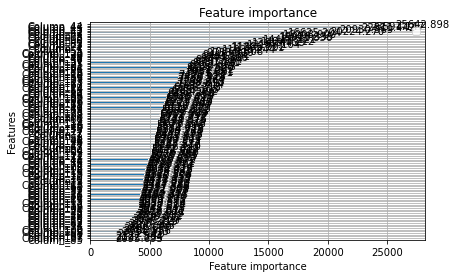

[850]	training's MSE_Modified_1: 0.176852	valid_1's MSE_Modified_1: 0.23073
[350]	training's MSE_Modified_1: 0.199605	valid_1's MSE_Modified_1: 0.237102
[850]	training's MSE_Modified_1: 0.17732	valid_1's MSE_Modified_1: 0.230616


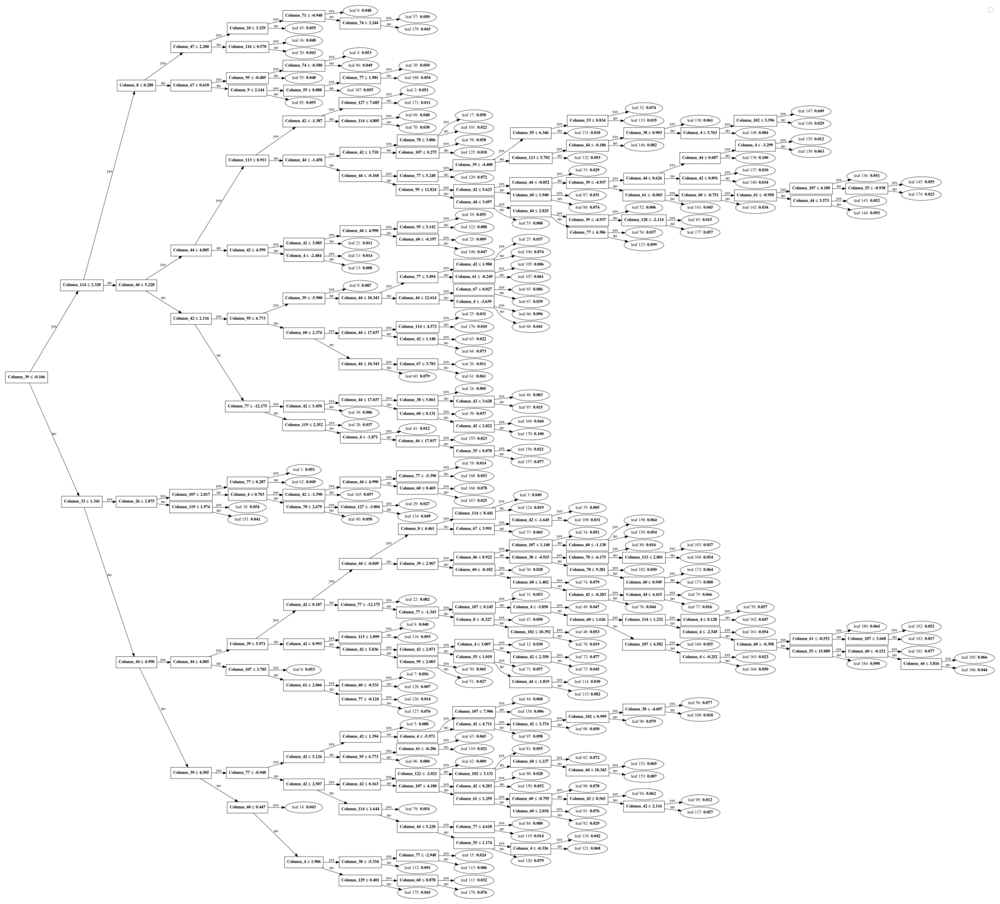

None
[900]	training's MSE_Modified_1: 0.174033	valid_1's MSE_Modified_1: 0.23059
[900]	training's MSE_Modified_1: 0.174489	valid_1's MSE_Modified_1: 0.230543
[400]	training's MSE_Modified_1: 0.194703	valid_1's MSE_Modified_1: 0.237038
[950]	training's MSE_Modified_1: 0.171361	valid_1's MSE_Modified_1: 0.230588


[I 2021-01-02 15:47:41,894] Trial 16 finished with value: 0.49962501032877354 and parameters: {'lambda_l1': 0.10338234366148401, 'lambda_l2': 0.44783026940485104, 'num_leaves': 189, 'feature_fraction': 0.44450623083355245, 'bagging_fraction': 0.7473338448487572, 'bagging_freq': 5, 'min_child_samples': 32}. Best is trial 7 with value: 0.49939036582465873.


Utility Score = 0.49962501032877354
[950]	training's MSE_Modified_1: 0.171708	valid_1's MSE_Modified_1: 0.230385
Training until validation scores don't improve for 50 rounds
[1000]	training's MSE_Modified_1: 0.168622	valid_1's MSE_Modified_1: 0.230436
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.168622	valid_1's MSE_Modified_1: 0.230436


<Figure size 432x288 with 0 Axes>

[1000]	training's MSE_Modified_1: 0.169089	valid_1's MSE_Modified_1: 0.230288
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.169089	valid_1's MSE_Modified_1: 0.230288


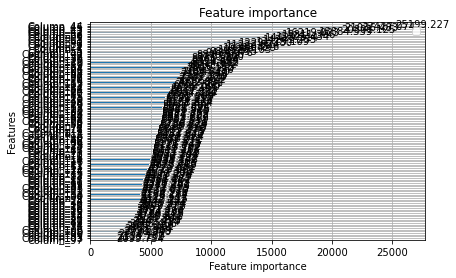

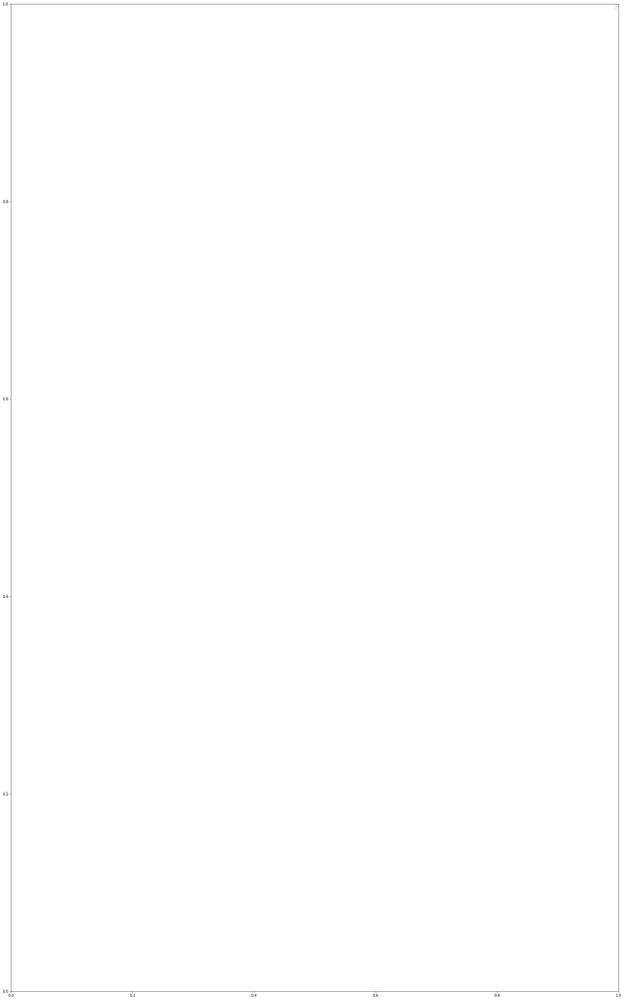

Early stopping, best iteration is:
[399]	training's MSE_Modified_1: 0.194783	valid_1's MSE_Modified_1: 0.237028


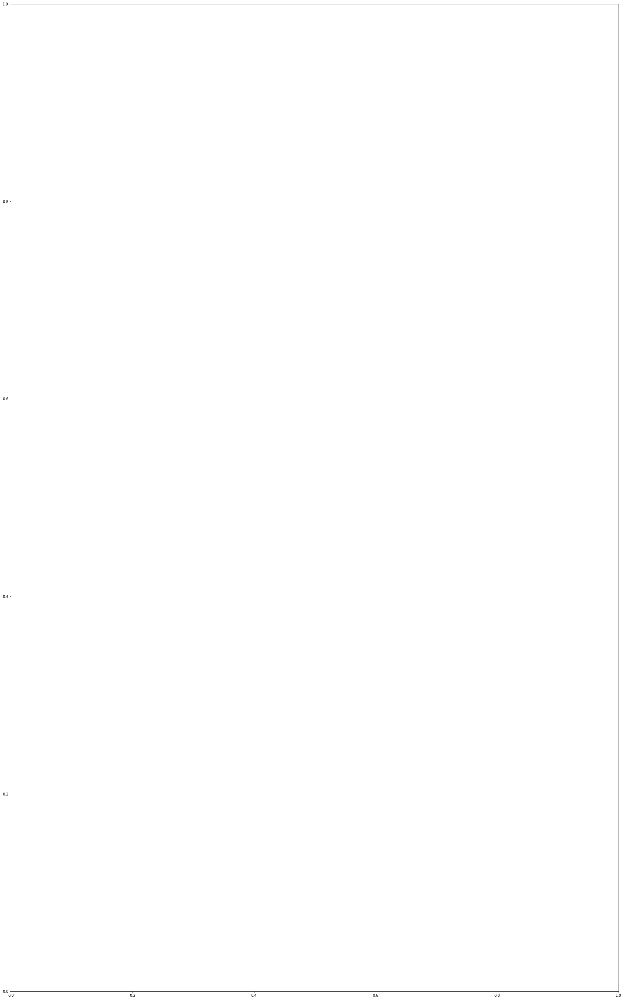

<Figure size 432x288 with 0 Axes>

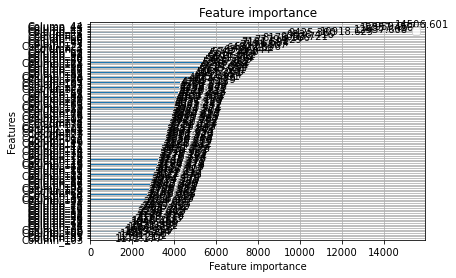

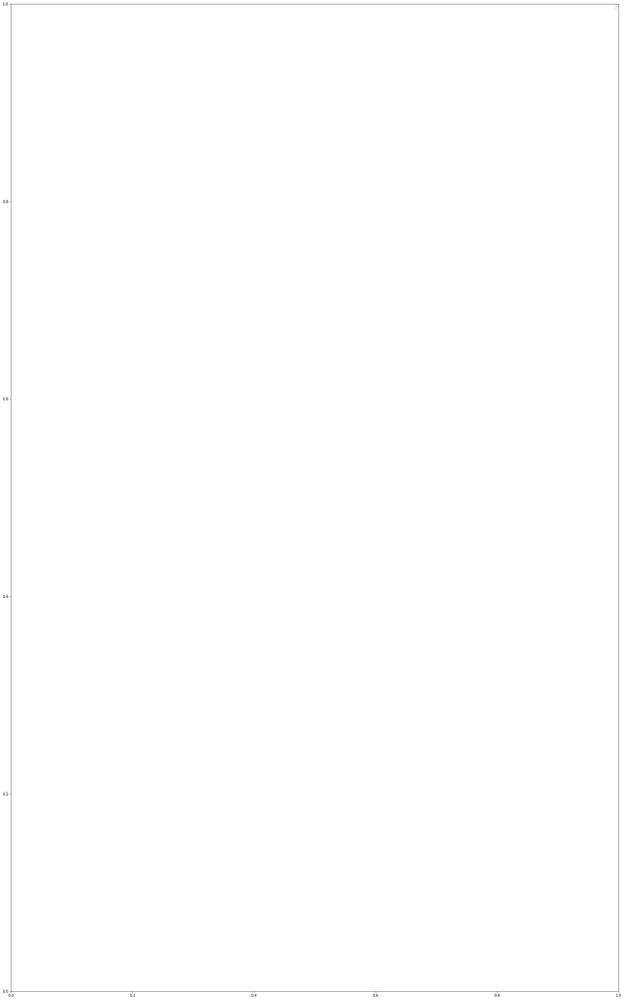

None


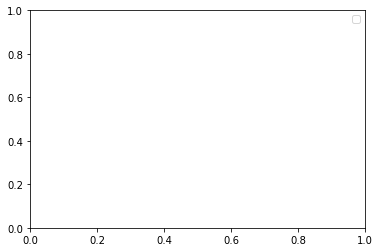

None


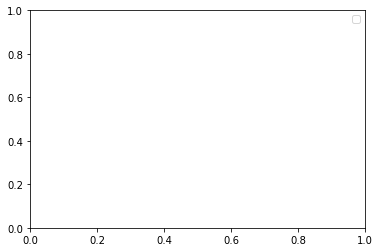

None


[I 2021-01-02 15:50:53,231] Trial 19 finished with value: 0.5003453437258141 and parameters: {'lambda_l1': 0.2676758843712144, 'lambda_l2': 0.15131152626959207, 'num_leaves': 253, 'feature_fraction': 0.9188496905801231, 'bagging_fraction': 0.41222885795940567, 'bagging_freq': 4, 'min_child_samples': 30}. Best is trial 7 with value: 0.49939036582465873.


Utility Score = 0.5003453437258141


[I 2021-01-02 15:50:57,907] Trial 18 finished with value: 0.49971016357623455 and parameters: {'lambda_l1': 0.2686712231134871, 'lambda_l2': 0.15913372179120394, 'num_leaves': 184, 'feature_fraction': 0.40571689678068884, 'bagging_fraction': 0.7365496304148405, 'bagging_freq': 5, 'min_child_samples': 35}. Best is trial 7 with value: 0.49939036582465873.


Utility Score = 0.49971016357623455


[I 2021-01-02 15:51:23,069] Trial 17 finished with value: 0.5011262305432714 and parameters: {'lambda_l1': 0.2637499408721526, 'lambda_l2': 0.15645883245622777, 'num_leaves': 192, 'feature_fraction': 0.40015712529726916, 'bagging_fraction': 0.7467126281945946, 'bagging_freq': 5, 'min_child_samples': 100}. Best is trial 7 with value: 0.49939036582465873.


Utility Score = 0.5011262305432714
[50]	training's MSE_Modified_1: 0.234456	valid_1's MSE_Modified_1: 0.239451
Training until validation scores don't improve for 50 rounds
Training until validation scores don't improve for 50 rounds
Training until validation scores don't improve for 50 rounds
[50]	training's MSE_Modified_1: 0.235961	valid_1's MSE_Modified_1: 0.239912
[100]	training's MSE_Modified_1: 0.226131	valid_1's MSE_Modified_1: 0.236368
[50]	training's MSE_Modified_1: 0.235797	valid_1's MSE_Modified_1: 0.24002
[50]	training's MSE_Modified_1: 0.235096	valid_1's MSE_Modified_1: 0.239582
[100]	training's MSE_Modified_1: 0.228912	valid_1's MSE_Modified_1: 0.237123
[100]	training's MSE_Modified_1: 0.227966	valid_1's MSE_Modified_1: 0.236289
[150]	training's MSE_Modified_1: 0.219575	valid_1's MSE_Modified_1: 0.234665
[150]	training's MSE_Modified_1: 0.223076	valid_1's MSE_Modified_1: 0.235291
[100]	training's MSE_Modified_1: 0.227082	valid_1's MSE_Modified_1: 0.235941
[150]	training's 

<Figure size 432x288 with 0 Axes>

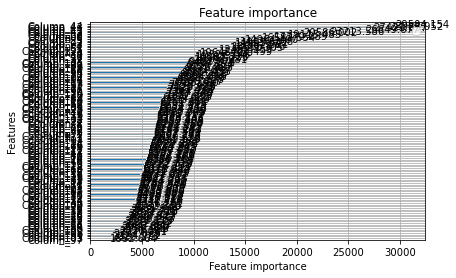

[850]	training's MSE_Modified_1: 0.153425	valid_1's MSE_Modified_1: 0.226726
[950]	training's MSE_Modified_1: 0.156191	valid_1's MSE_Modified_1: 0.225305


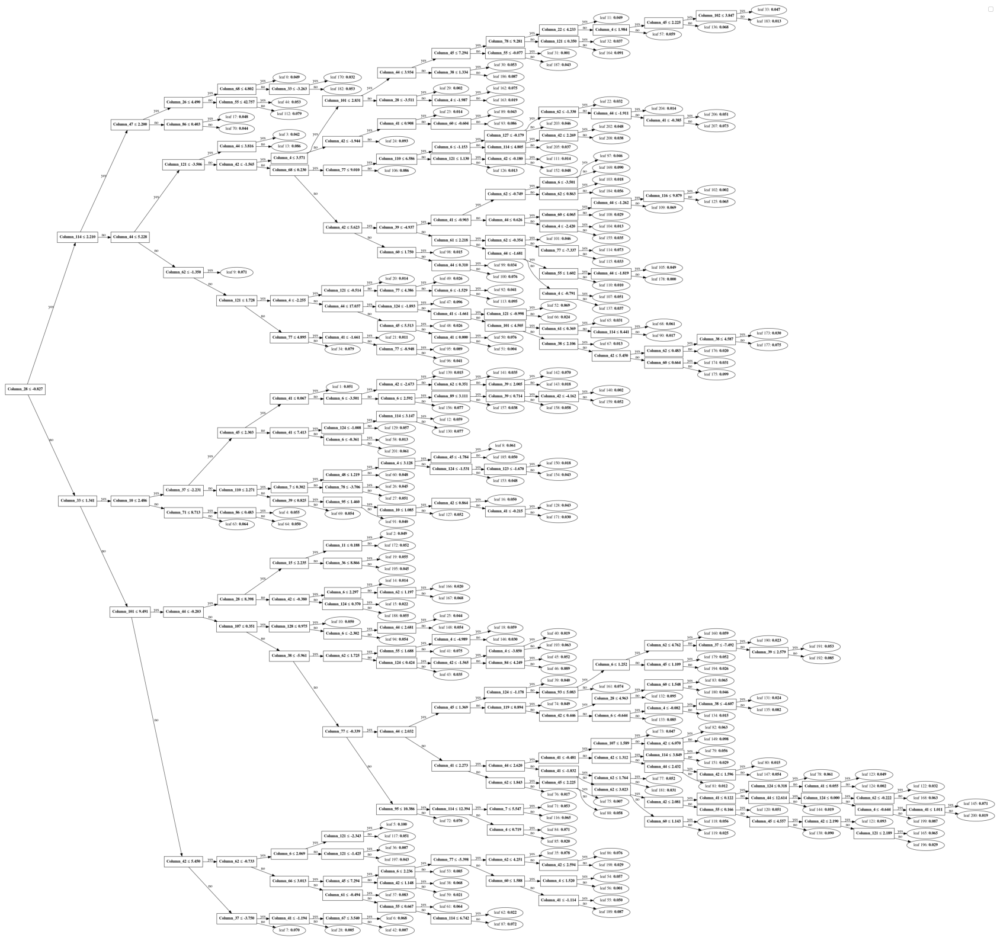

None
[800]	training's MSE_Modified_1: 0.162479	valid_1's MSE_Modified_1: 0.22558
[900]	training's MSE_Modified_1: 0.149979	valid_1's MSE_Modified_1: 0.226604
[1000]	training's MSE_Modified_1: 0.153136	valid_1's MSE_Modified_1: 0.225137
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.153136	valid_1's MSE_Modified_1: 0.225137


<Figure size 432x288 with 0 Axes>

[I 2021-01-02 16:22:56,858] Trial 21 finished with value: 0.4993443199945502 and parameters: {'lambda_l1': 0.3133684388140031, 'lambda_l2': 0.3427579758335774, 'num_leaves': 209, 'feature_fraction': 0.7095886445494517, 'bagging_fraction': 0.7422286083987177, 'bagging_freq': 6, 'min_child_samples': 32}. Best is trial 21 with value: 0.4993443199945502.


Utility Score = 0.4993443199945502


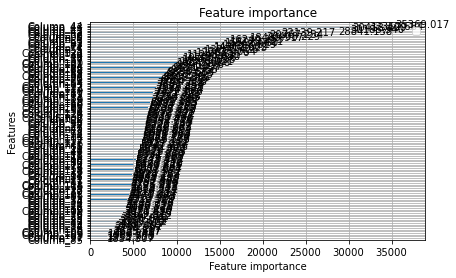

[850]	training's MSE_Modified_1: 0.159145	valid_1's MSE_Modified_1: 0.225402
Training until validation scores don't improve for 50 rounds


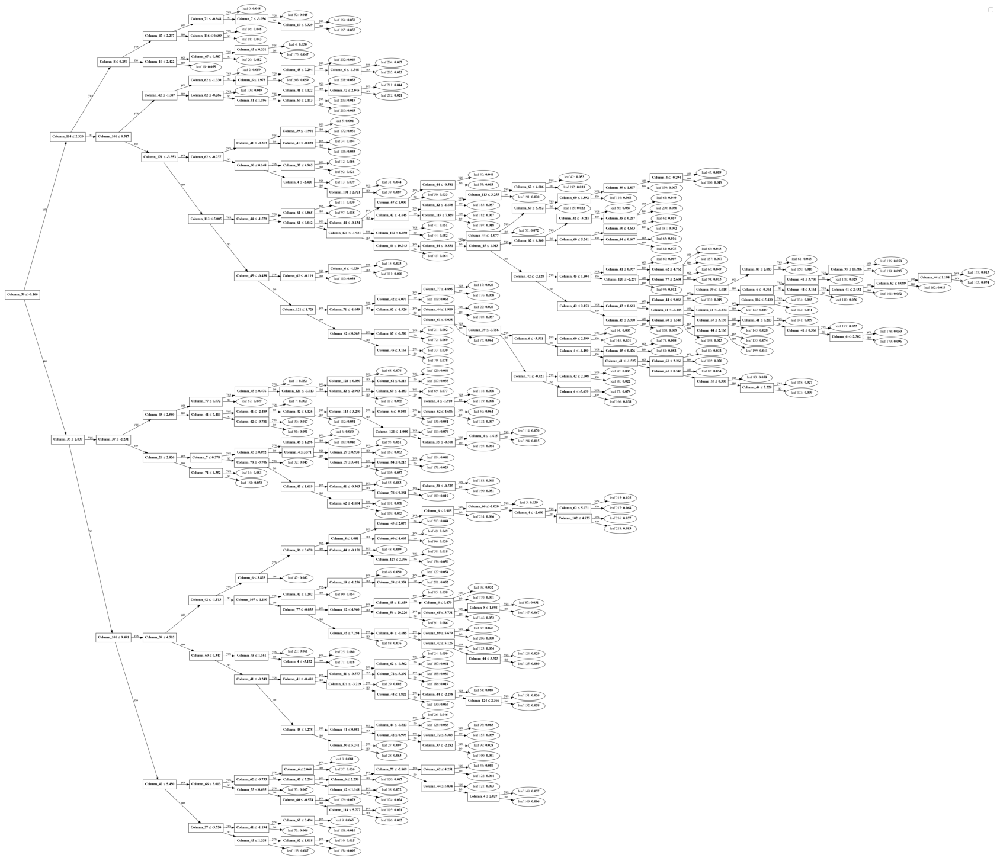

None
[950]	training's MSE_Modified_1: 0.14649	valid_1's MSE_Modified_1: 0.226458
[900]	training's MSE_Modified_1: 0.155757	valid_1's MSE_Modified_1: 0.225123


[I 2021-01-02 16:25:42,538] Trial 22 finished with value: 0.5000797917466949 and parameters: {'lambda_l1': 0.6660075911163508, 'lambda_l2': 0.3370903708475458, 'num_leaves': 219, 'feature_fraction': 0.7083350369523559, 'bagging_fraction': 0.8446978173574442, 'bagging_freq': 6, 'min_child_samples': 25}. Best is trial 21 with value: 0.4993443199945502.


Utility Score = 0.5000797917466949
[50]	training's MSE_Modified_1: 0.236021	valid_1's MSE_Modified_1: 0.240281
[1000]	training's MSE_Modified_1: 0.143142	valid_1's MSE_Modified_1: 0.22606
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.143142	valid_1's MSE_Modified_1: 0.22606


<Figure size 432x288 with 0 Axes>

Training until validation scores don't improve for 50 rounds
[950]	training's MSE_Modified_1: 0.15257	valid_1's MSE_Modified_1: 0.225061


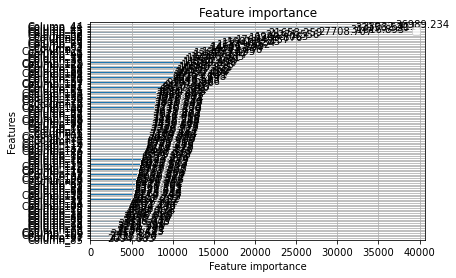

[100]	training's MSE_Modified_1: 0.228573	valid_1's MSE_Modified_1: 0.237352


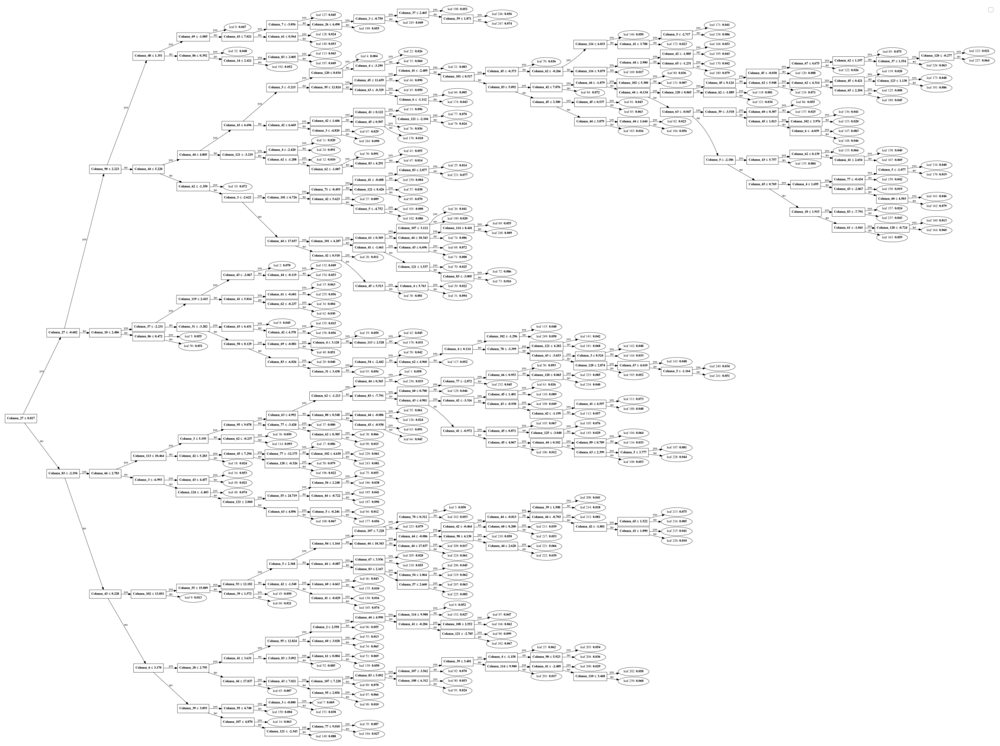

None
[1000]	training's MSE_Modified_1: 0.149429	valid_1's MSE_Modified_1: 0.224806
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.149429	valid_1's MSE_Modified_1: 0.224806


<Figure size 432x288 with 0 Axes>

[50]	training's MSE_Modified_1: 0.236311	valid_1's MSE_Modified_1: 0.240464


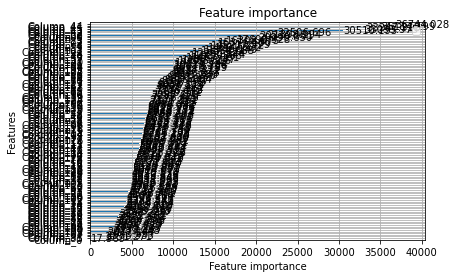

[I 2021-01-02 16:29:06,332] Trial 20 finished with value: 0.5000167152670942 and parameters: {'lambda_l1': 0.2664600058201381, 'lambda_l2': 0.3541375425187463, 'num_leaves': 250, 'feature_fraction': 0.9136863244393201, 'bagging_fraction': 0.7473630932127152, 'bagging_freq': 6, 'min_child_samples': 30}. Best is trial 21 with value: 0.4993443199945502.


Utility Score = 0.5000167152670942
[150]	training's MSE_Modified_1: 0.221947	valid_1's MSE_Modified_1: 0.234681


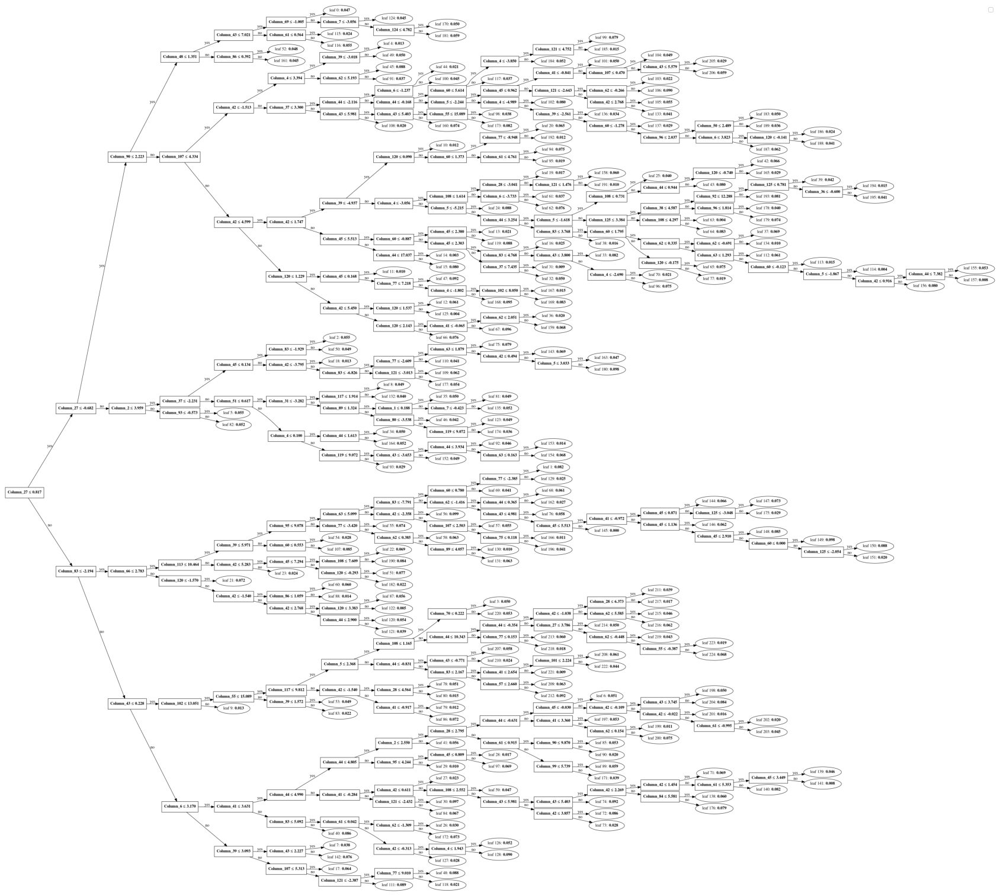

None
Training until validation scores don't improve for 50 rounds
[100]	training's MSE_Modified_1: 0.229123	valid_1's MSE_Modified_1: 0.23751


[I 2021-01-02 16:31:10,753] Trial 23 finished with value: 0.5000116691487262 and parameters: {'lambda_l1': 0.6331628707674816, 'lambda_l2': 0.32738262395033607, 'num_leaves': 225, 'feature_fraction': 0.9095206373010996, 'bagging_fraction': 0.8339889107660433, 'bagging_freq': 6, 'min_child_samples': 27}. Best is trial 21 with value: 0.4993443199945502.


[200]	training's MSE_Modified_1: 0.21632	valid_1's MSE_Modified_1: 0.233298
Utility Score = 0.5000116691487262
[50]	training's MSE_Modified_1: 0.236745	valid_1's MSE_Modified_1: 0.240979
Training until validation scores don't improve for 50 rounds
[150]	training's MSE_Modified_1: 0.22311	valid_1's MSE_Modified_1: 0.235528
[250]	training's MSE_Modified_1: 0.211202	valid_1's MSE_Modified_1: 0.232296
[100]	training's MSE_Modified_1: 0.22959	valid_1's MSE_Modified_1: 0.238024
[200]	training's MSE_Modified_1: 0.217754	valid_1's MSE_Modified_1: 0.234394
[50]	training's MSE_Modified_1: 0.238452	valid_1's MSE_Modified_1: 0.241416
[300]	training's MSE_Modified_1: 0.206204	valid_1's MSE_Modified_1: 0.231468
[250]	training's MSE_Modified_1: 0.213092	valid_1's MSE_Modified_1: 0.233704
[150]	training's MSE_Modified_1: 0.223653	valid_1's MSE_Modified_1: 0.236264
[100]	training's MSE_Modified_1: 0.233033	valid_1's MSE_Modified_1: 0.239169
[350]	training's MSE_Modified_1: 0.201112	valid_1's MSE_Modifi

<Figure size 432x288 with 0 Axes>

[850]	training's MSE_Modified_1: 0.182591	valid_1's MSE_Modified_1: 0.230468


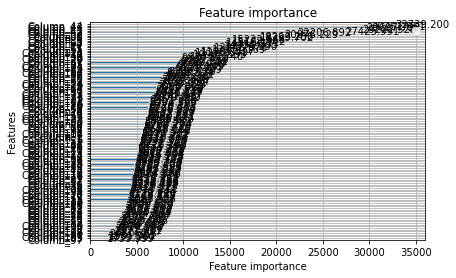

[900]	training's MSE_Modified_1: 0.162013	valid_1's MSE_Modified_1: 0.226966
[850]	training's MSE_Modified_1: 0.167739	valid_1's MSE_Modified_1: 0.229916
[900]	training's MSE_Modified_1: 0.179958	valid_1's MSE_Modified_1: 0.230238


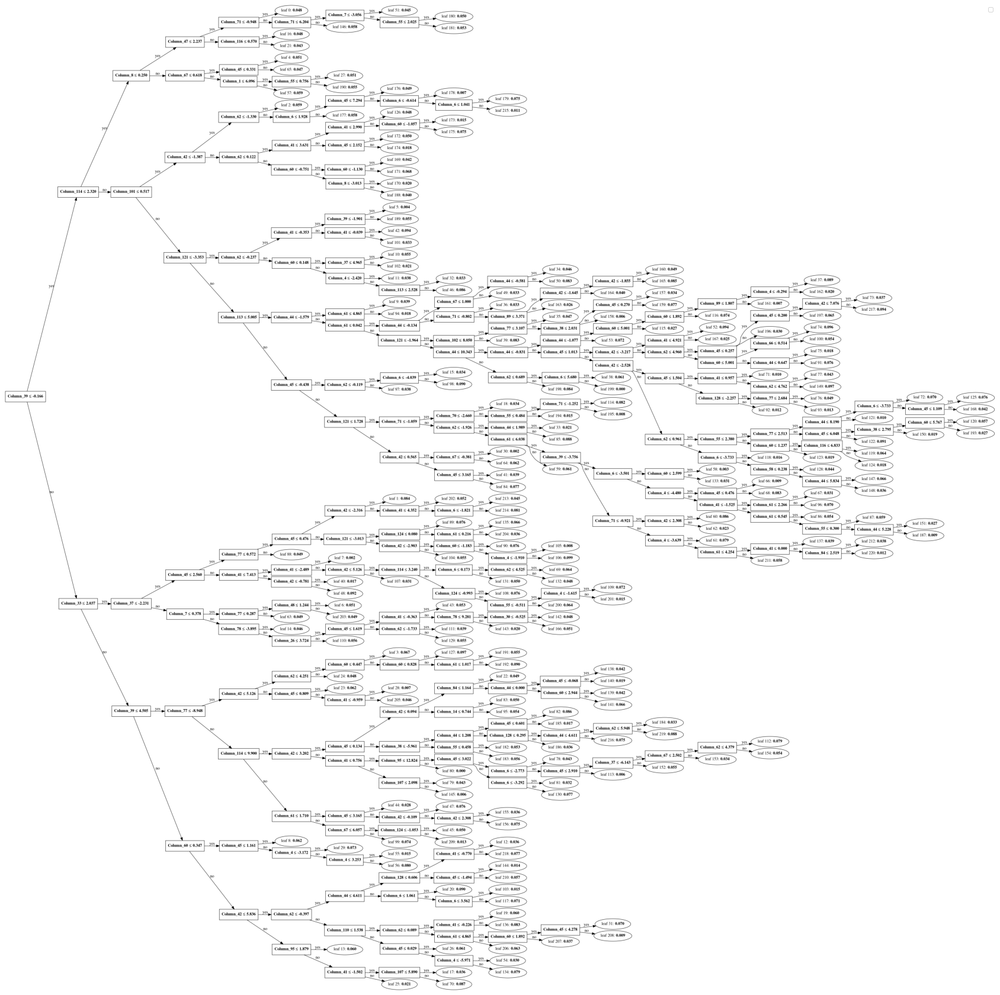

None
[950]	training's MSE_Modified_1: 0.158967	valid_1's MSE_Modified_1: 0.226898
[900]	training's MSE_Modified_1: 0.164618	valid_1's MSE_Modified_1: 0.229747
[950]	training's MSE_Modified_1: 0.177238	valid_1's MSE_Modified_1: 0.229985


[I 2021-01-02 16:54:52,865] Trial 24 finished with value: 0.4992194285649407 and parameters: {'lambda_l1': 0.34771745441494845, 'lambda_l2': 0.33783274970686694, 'num_leaves': 221, 'feature_fraction': 0.7114834491391162, 'bagging_fraction': 0.8281468198820121, 'bagging_freq': 6, 'min_child_samples': 22}. Best is trial 24 with value: 0.4992194285649407.


Utility Score = 0.4992194285649407
[1000]	training's MSE_Modified_1: 0.155962	valid_1's MSE_Modified_1: 0.226642
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.155962	valid_1's MSE_Modified_1: 0.226642


<Figure size 432x288 with 0 Axes>

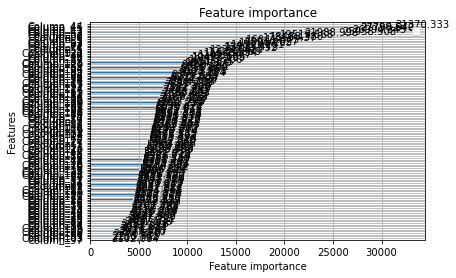

[950]	training's MSE_Modified_1: 0.161524	valid_1's MSE_Modified_1: 0.229691
Training until validation scores don't improve for 50 rounds
[1000]	training's MSE_Modified_1: 0.174593	valid_1's MSE_Modified_1: 0.229755
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.174593	valid_1's MSE_Modified_1: 0.229755


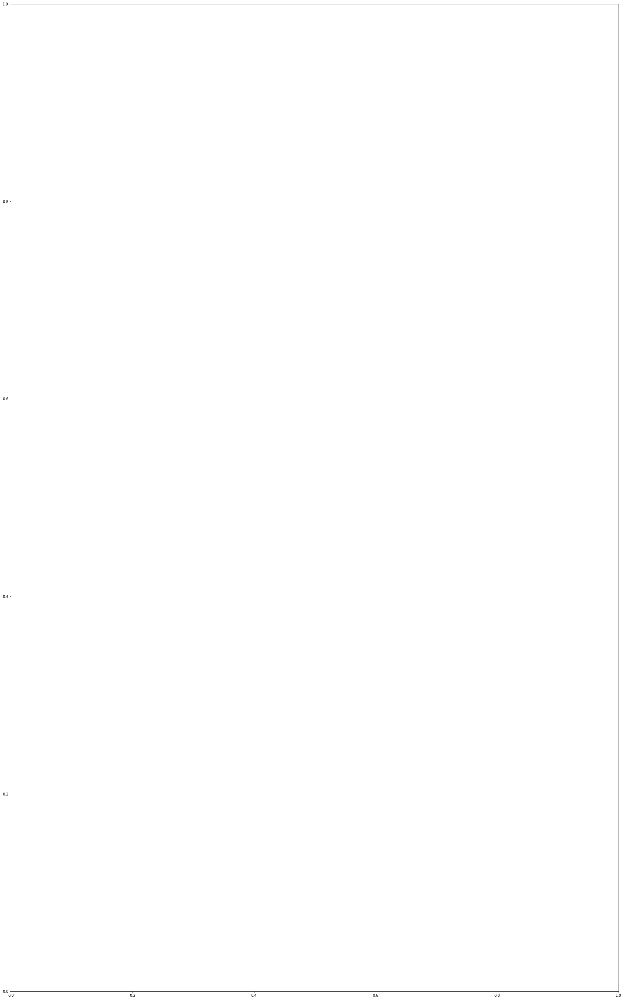

<Figure size 432x288 with 0 Axes>

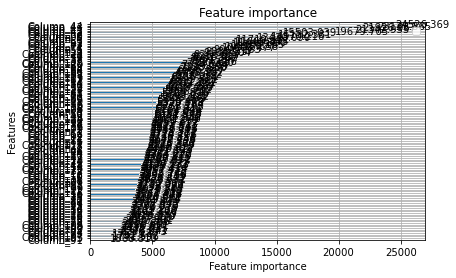

<Figure size 2160x3600 with 0 Axes>

None


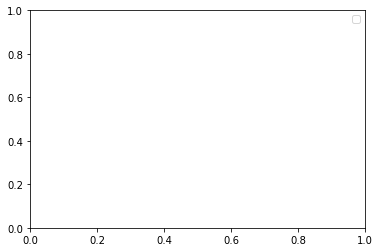

None
[1000]	training's MSE_Modified_1: 0.158429	valid_1's MSE_Modified_1: 0.229419
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.158429	valid_1's MSE_Modified_1: 0.229419


<Figure size 432x288 with 0 Axes>

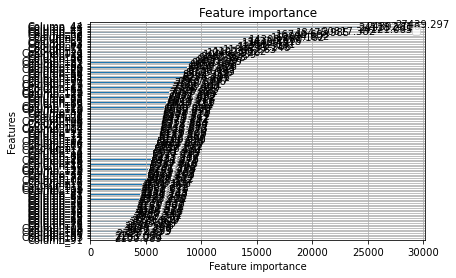

[I 2021-01-02 16:57:28,366] Trial 25 finished with value: 0.49967799457163814 and parameters: {'lambda_l1': 0.34977299060732125, 'lambda_l2': 0.4899601175023248, 'num_leaves': 215, 'feature_fraction': 0.6320395123291197, 'bagging_fraction': 0.8020730270553271, 'bagging_freq': 6, 'min_child_samples': 41}. Best is trial 24 with value: 0.4992194285649407.


Utility Score = 0.49967799457163814


[I 2021-01-02 16:57:48,960] Trial 27 finished with value: 0.49965907162775797 and parameters: {'lambda_l1': 0.3660683632087528, 'lambda_l2': 0.5230170585252517, 'num_leaves': 156, 'feature_fraction': 0.6203429116092746, 'bagging_fraction': 0.6986155595124403, 'bagging_freq': 6, 'min_child_samples': 42}. Best is trial 24 with value: 0.4992194285649407.


Utility Score = 0.49965907162775797
[50]	training's MSE_Modified_1: 0.23854	valid_1's MSE_Modified_1: 0.241433
Training until validation scores don't improve for 50 rounds


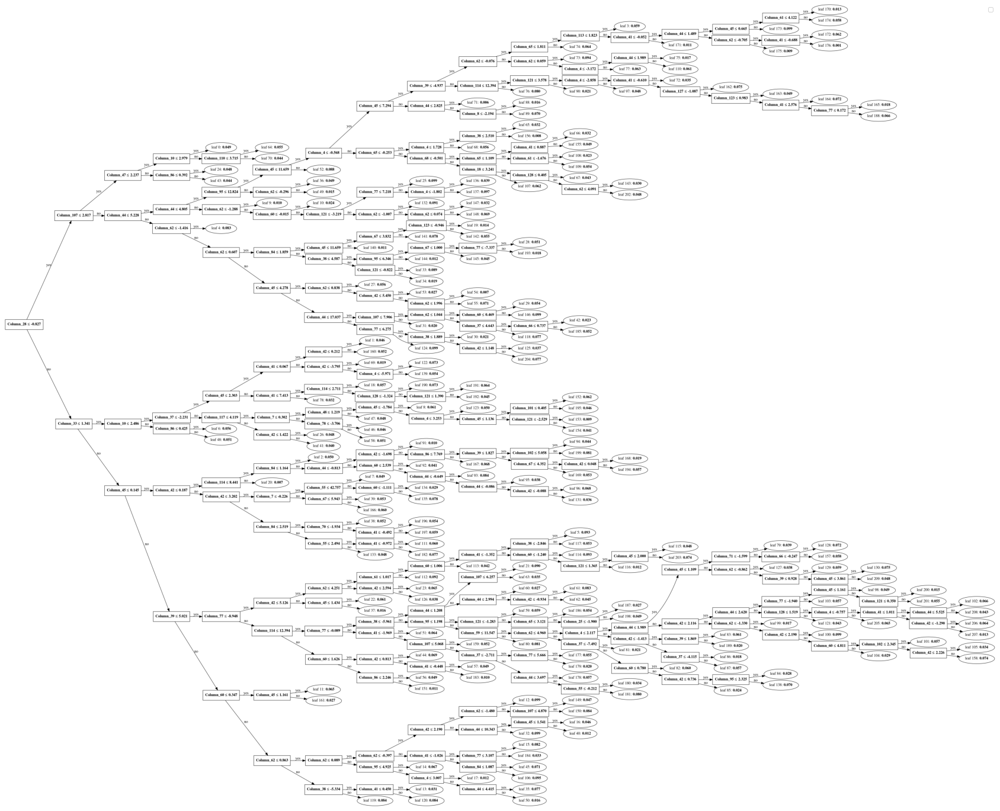

None
[50]	training's MSE_Modified_1: 0.243032	valid_1's MSE_Modified_1: 0.244251


[I 2021-01-02 16:59:17,604] Trial 26 finished with value: 0.49975116328797503 and parameters: {'lambda_l1': 0.3576768669080585, 'lambda_l2': 0.5447647830321067, 'num_leaves': 210, 'feature_fraction': 0.6283800113743312, 'bagging_fraction': 0.6861280515644086, 'bagging_freq': 6, 'min_child_samples': 41}. Best is trial 24 with value: 0.4992194285649407.


Utility Score = 0.49975116328797503
[100]	training's MSE_Modified_1: 0.232846	valid_1's MSE_Modified_1: 0.238691
[100]	training's MSE_Modified_1: 0.239831	valid_1's MSE_Modified_1: 0.242345
[150]	training's MSE_Modified_1: 0.227879	valid_1's MSE_Modified_1: 0.236423
[150]	training's MSE_Modified_1: 0.237006	valid_1's MSE_Modified_1: 0.240717
[200]	training's MSE_Modified_1: 0.223106	valid_1's MSE_Modified_1: 0.23455
[200]	training's MSE_Modified_1: 0.234509	valid_1's MSE_Modified_1: 0.239442
[250]	training's MSE_Modified_1: 0.232193	valid_1's MSE_Modified_1: 0.238462
[250]	training's MSE_Modified_1: 0.219163	valid_1's MSE_Modified_1: 0.233458
[300]	training's MSE_Modified_1: 0.229904	valid_1's MSE_Modified_1: 0.237411
[300]	training's MSE_Modified_1: 0.215099	valid_1's MSE_Modified_1: 0.232294
[350]	training's MSE_Modified_1: 0.22795	valid_1's MSE_Modified_1: 0.23673
[350]	training's MSE_Modified_1: 0.211478	valid_1's MSE_Modified_1: 0.231381
[400]	training's MSE_Modified_1: 0.225948	v

<Figure size 432x288 with 0 Axes>

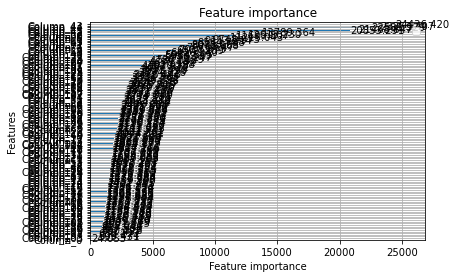

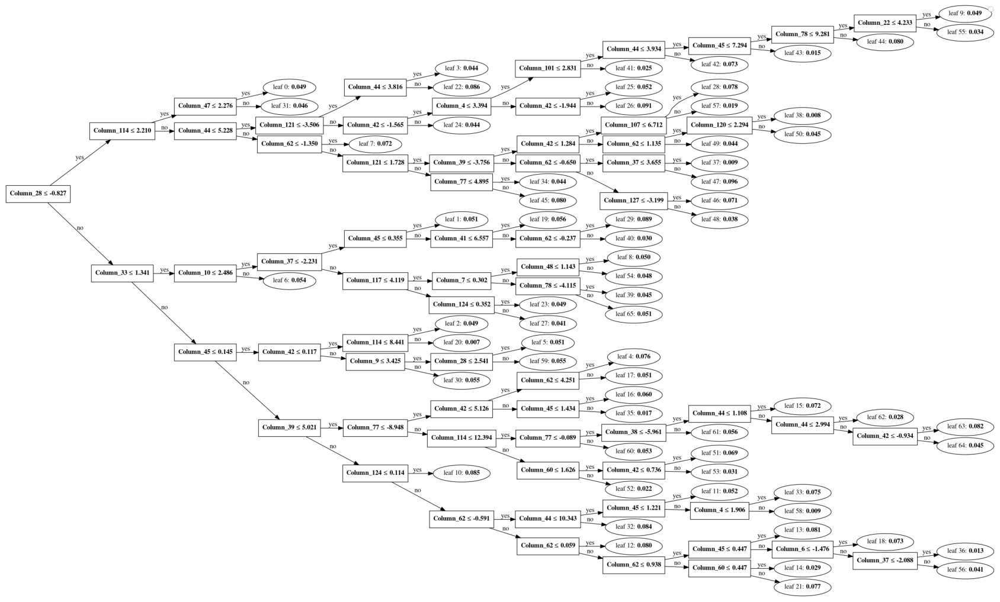

None
[850]	training's MSE_Modified_1: 0.181112	valid_1's MSE_Modified_1: 0.22634


[I 2021-01-02 17:09:48,705] Trial 29 finished with value: 0.4999839154977018 and parameters: {'lambda_l1': 0.39032448689608307, 'lambda_l2': 0.19564831177513778, 'num_leaves': 66, 'feature_fraction': 0.7525631516788718, 'bagging_fraction': 0.9281266378606867, 'bagging_freq': 6, 'min_child_samples': 21}. Best is trial 24 with value: 0.4992194285649407.


Utility Score = 0.4999839154977018
[900]	training's MSE_Modified_1: 0.178523	valid_1's MSE_Modified_1: 0.226164
[950]	training's MSE_Modified_1: 0.176126	valid_1's MSE_Modified_1: 0.226047
[1000]	training's MSE_Modified_1: 0.173621	valid_1's MSE_Modified_1: 0.225614
Did not meet early stopping. Best iteration is:
[1000]	training's MSE_Modified_1: 0.173621	valid_1's MSE_Modified_1: 0.225614


<Figure size 432x288 with 0 Axes>

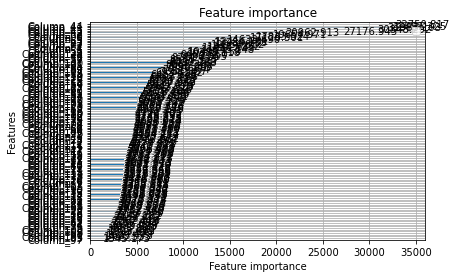

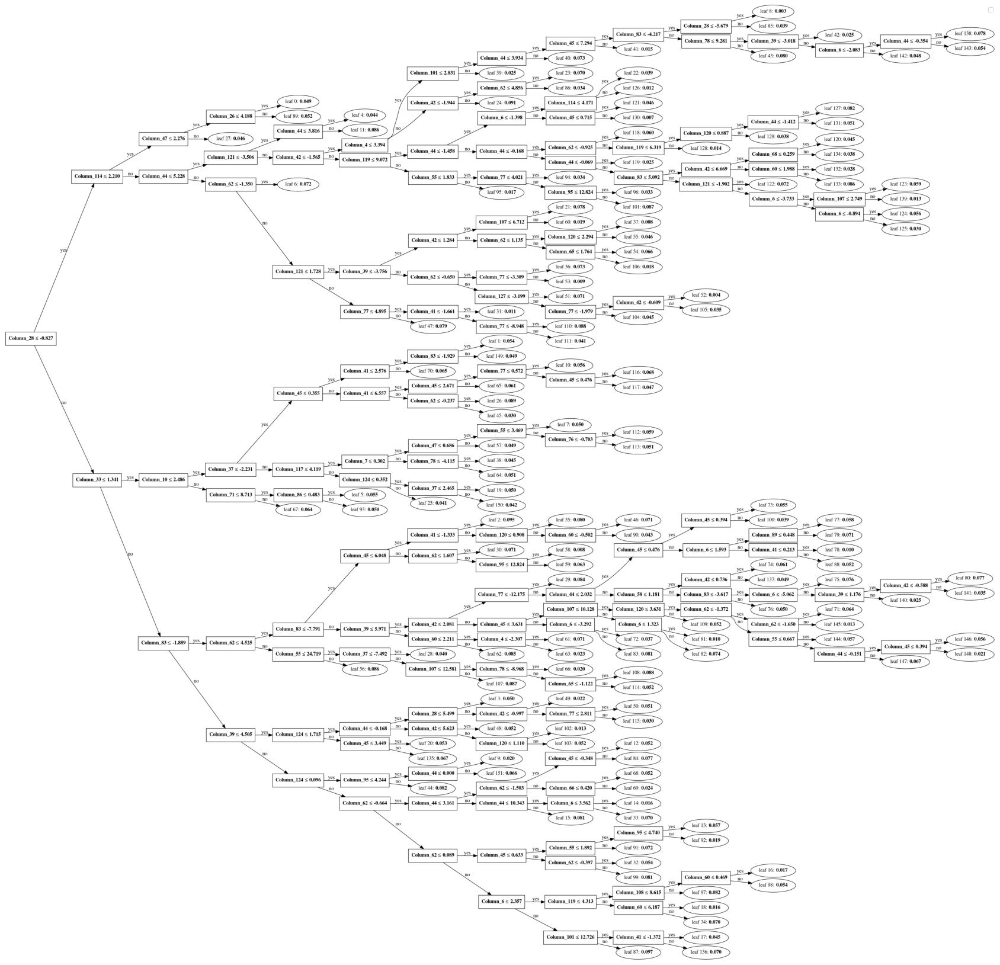

None


[I 2021-01-02 17:11:02,275] Trial 28 finished with value: 0.5001296221655795 and parameters: {'lambda_l1': 0.33189184858739584, 'lambda_l2': 0.5286263457044629, 'num_leaves': 152, 'feature_fraction': 0.7624397829296762, 'bagging_fraction': 0.9269172063438174, 'bagging_freq': 6, 'min_child_samples': 42}. Best is trial 24 with value: 0.4992194285649407.


Utility Score = 0.5001296221655795
CPU times: user 9h 51min 34s, sys: 2h 55min 44s, total: 12h 47min 19s
Wall time: 3h 20min 25s


In [16]:
%%time
# Optimize Hyperparameters.
study = optuna.create_study(direction = 'minimize', sampler = TPESampler(seed=int(SEED)))
study.optimize(objective, n_trials = n_trials, n_jobs = multiprocessing.cpu_count())

In [17]:
%%time
print('Optimized Hyperparameters:')
print(study.best_trial.params)

Optimized Hyperparameters:
{'lambda_l1': 0.34771745441494845, 'lambda_l2': 0.33783274970686694, 'num_leaves': 221, 'feature_fraction': 0.7114834491391162, 'bagging_fraction': 0.8281468198820121, 'bagging_freq': 6, 'min_child_samples': 22}
CPU times: user 320 µs, sys: 97 µs, total: 417 µs
Wall time: 382 µs


# [LightGBM Classifier](https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.LGBMClassifier.html)
### Eval_mse_modified_3 & 4
1. Fine-tune Eval_mse_modified_1 to apply to LightGBM.LGBMClassifier.fit()
1. See following:
    - [lightgbm.LGBMClassifier](https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.LGBMClassifier.html)
    - [Using custom eval_metric with sklearn API](https://github.com/microsoft/LightGBM/issues/3029)

In [18]:
%%time
# Utility Score
def Eval_mse_modified_3(y_true, y_pred):
    lmbda = 0.2
    #weight = y_true.get_weight()
    # y_true = y_true.get_label()
    residual = (y_true - y_pred).astype("float")
    signs_matching = (y_true * y_pred) >= 0
    mse_action_value = np.where(signs_matching,  residual**2, residual**2 - y_true*y_pred*lmbda)
    return "MSE_Modified_3", np.mean(mse_action_value), False

def Eval_mse_modified_4(y_true, y_pred):
    lmbda = 2
    #weight = y_true.get_weight()
    #y_true = y_true.get_label()
    residual = (y_true - y_pred).astype("float")
    signs_matching = (y_true * y_pred) >= 0
    value = np.where(signs_matching,  residual**2, residual**2 + (y_true**2)*(y_pred**2)*lmbda)    
    #value = weight* value 
    return "MSE_Modified_4", np.mean(value), False

CPU times: user 1 µs, sys: 4 µs, total: 5 µs
Wall time: 9.54 µs


In [19]:
%%time
# Classifier model
Class = lgb.LGBMClassifier(
    task = 'train',
    boosting_type = 'gbdt',
    objective = 'binary',
    random_state = SEED,
    importance_type = 'gain',
    n_estimators = num_boost_round,
    n_jobs = multiprocessing.cpu_count(),
    metric = [Eval_mse_modified_3, Eval_mse_modified_4]
)
Class.set_params(
    **study.best_trial.params
)
Class.fit(
    X_train_adv, 
    y_train_adv,
    eval_set = [(X_train_adv, y_train_adv), (X_valid_adv, y_valid_adv)],
    eval_names = ['train', 'valid'],
    eval_metric = lambda y_true, y_pred: [Eval_mse_modified_3(y_true, y_pred), Eval_mse_modified_4(y_true, y_pred)],
    feature_name = FEATURES,
    early_stopping_rounds = early_stopping_rounds,
    verbose = verbose_eval
)

Training until validation scores don't improve for 50 rounds
[50]	train's MSE_Modified_3: 0.235842	train's MSE_Modified_4: 0.235842	valid's MSE_Modified_3: 0.239849	valid's MSE_Modified_4: 0.239849
[100]	train's MSE_Modified_3: 0.228127	train's MSE_Modified_4: 0.228127	valid's MSE_Modified_3: 0.236172	valid's MSE_Modified_4: 0.236172
[150]	train's MSE_Modified_3: 0.222266	train's MSE_Modified_4: 0.222266	valid's MSE_Modified_3: 0.23452	valid's MSE_Modified_4: 0.23452
[200]	train's MSE_Modified_3: 0.216068	train's MSE_Modified_4: 0.216068	valid's MSE_Modified_3: 0.232148	valid's MSE_Modified_4: 0.232148
[250]	train's MSE_Modified_3: 0.210938	train's MSE_Modified_4: 0.210938	valid's MSE_Modified_3: 0.230798	valid's MSE_Modified_4: 0.230798
[300]	train's MSE_Modified_3: 0.205897	train's MSE_Modified_4: 0.205897	valid's MSE_Modified_3: 0.229657	valid's MSE_Modified_4: 0.229657
[350]	train's MSE_Modified_3: 0.20103	train's MSE_Modified_4: 0.20103	valid's MSE_Modified_3: 0.228519	valid's MSE

LGBMClassifier(bagging_fraction=0.8281468198820121, bagging_freq=6,
               feature_fraction=0.7114834491391162, importance_type='gain',
               lambda_l1=0.34771745441494845, lambda_l2=0.33783274970686694,
               metric=[<function Eval_mse_modified_3 at 0x7f407ca18d40>,
                       <function Eval_mse_modified_4 at 0x7f407ca18950>],
               min_child_samples=22, n_estimators=1000, n_jobs=4,
               num_leaves=221, objective='binary', random_state=2000,
               task='train')

# [Plot & Summaries](https://www.kaggle.com/abiolatti/jane-street-market-baseline-logistic-regression#Plot-&-Summaries)

CPU times: user 4min 57s, sys: 4.23 s, total: 5min 2s
Wall time: 1min 29s


(0.4, 0.6)

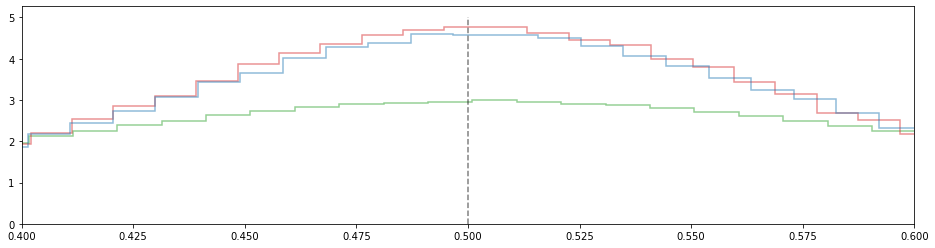

In [20]:
%%time
plt.figure(figsize=(16, 4))

pred_train = Class.predict_proba(X_train)[:, 1]
plt.hist(pred_train, 100, density=True, color='tab:green', alpha=0.5, histtype='step', linewidth=1.5)
if len(X_valid) > 0:
    pred_valid = Class.predict_proba(X_valid)[:, 1]
    plt.hist(pred_valid, 100, density=True, color='tab:red', alpha=0.5, histtype='step', linewidth=1.5)
if len(X_other) > 0:
    pred_other = Class.predict_proba(X_other)[:, 1]
    plt.hist(pred_other, 100, density=True, color='tab:blue', alpha=0.5, histtype='step', linewidth=1.5)

plt.vlines(0.5, *plt.ylim(), color='k', alpha=0.5, linestyle='--')
plt.xlim(0.4, 0.6);

CPU times: user 132 ms, sys: 697 µs, total: 133 ms
Wall time: 133 ms


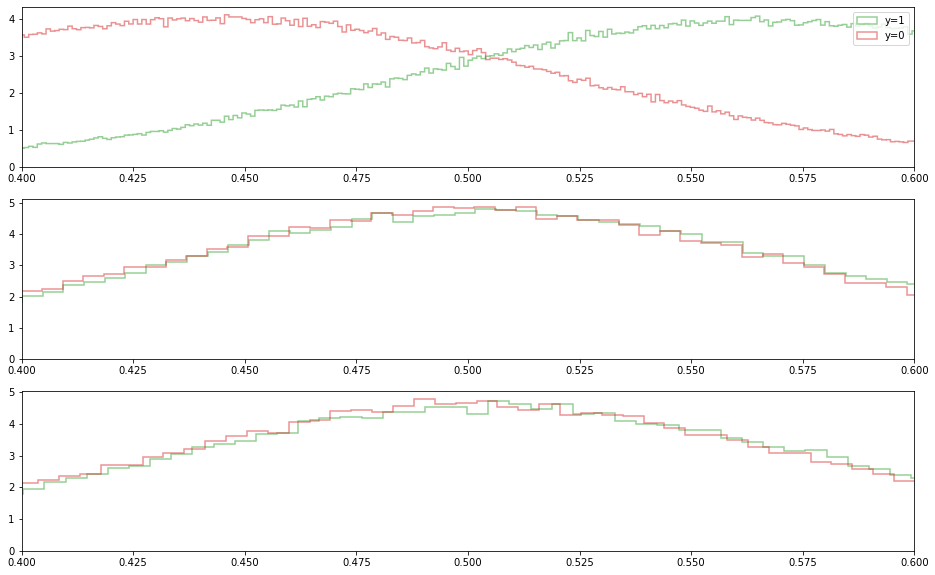

In [21]:
%%time
plt.figure(figsize=(16, 10))
plt.title("Prediction by target")
plt.subplot(3, 1, 1)
if len(X_train) > 0:
    plt.hist(pred_train[y_train >= 0.5], 1000, density=True, color='tab:green', alpha=0.5, histtype='step', linewidth=1.5, label='y=1')
    plt.hist(pred_train[y_train < 0.5], 1000, density=True, color='tab:red', alpha=0.5, histtype='step', linewidth=1.5, label='y=0')
    plt.xlim(0.4, 0.6)
    plt.legend()

plt.subplot(3, 1, 2)
if len(X_valid) > 0:
    plt.hist(pred_valid[y_valid >= 0.5], 200, density=True, color='tab:green', alpha=0.5, histtype='step', linewidth=1.5)
    plt.hist(pred_valid[y_valid < 0.5], 200, density=True, color='tab:red', alpha=0.5, histtype='step', linewidth=1.5)
    plt.xlim(0.4, 0.6)
    
plt.subplot(3, 1, 3)
if len(X_other) > 0:
    plt.hist(pred_other[y_other >= 0.5], 200, density=True, color='tab:green', alpha=0.5, histtype='step', linewidth=1.5)
    plt.hist(pred_other[y_other < 0.5], 200, density=True, color='tab:red', alpha=0.5, histtype='step', linewidth=1.5)
    plt.xlim(0.4, 0.6)

In [22]:
%%time
print("Train Score = %.4f" % utility(data.loc[idxT], pred_train > 0.5))
if len(X_valid) > 0:
    print("Valid Score = %.4f" % utility(data.loc[idxV], pred_valid > 0.5))
if len(X_other) > 0:
    print("Other Score = %.4f" % utility(data.loc[idxO], pred_other > 0.5))

Train Score = 127469.5647
Valid Score = 18.9397
Other Score = 327.4603
CPU times: user 2.59 s, sys: 307 ms, total: 2.9 s
Wall time: 3.06 s


In [23]:
%%time
res = pd.DataFrame()
frac = 0.6
thr_list = np.linspace(0.47, 0.53, 51)
for rep in tqdm(range(10)):
    for thr in thr_list:
        sample_idx = data.loc[idxO].reset_index().sample(frac=frac).index.tolist()
        ut = utility(data.loc[idxO].iloc[sample_idx], pred_other[sample_idx] > thr)
        res = pd.concat([res, pd.DataFrame({'rep': rep, 'thr': thr, 'ut': ut}, index=[0])], axis=0).reset_index(drop=True)


CPU times: user 2min 18s, sys: 12.3 s, total: 2min 31s
Wall time: 2min 31s


Best threshold = 0.5252
CPU times: user 44.2 ms, sys: 0 ns, total: 44.2 ms
Wall time: 75.5 ms


Text(0.5, 1.0, 'Best threshold')

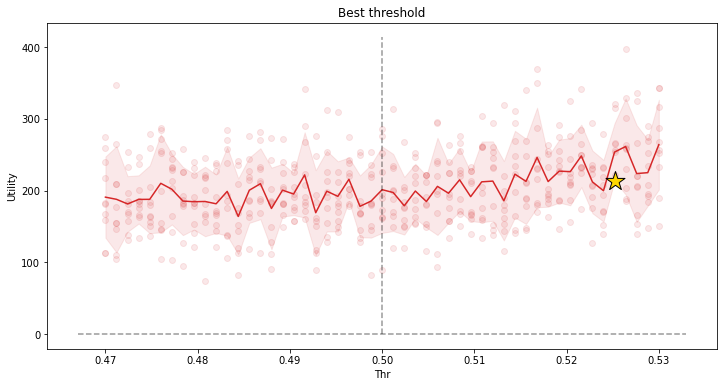

In [24]:
%%time
# use the lower bound to choose the threshold
plt.figure(figsize=(12, 6))
plt.scatter(res['thr'], res['ut'], color='tab:red', alpha=0.1, zorder=0)

res_agg = res.groupby('thr')['ut'].agg(['mean', 'std'])
res_agg['lwb'] = res_agg['mean'] - 1 * res_agg['std']
res_agg['upb'] = res_agg['mean'] + 1 * res_agg['std']
plt.plot(res_agg.index, res_agg['mean'], color='tab:red', zorder=-1)
plt.fill_between(res_agg.index, res_agg['lwb'], res_agg['upb'], color='tab:red', alpha=0.1, zorder=-2)

lwb_best = float(res_agg['lwb'].max())
thr_best = float(res_agg.index[res_agg['lwb'].argmax()])
print("Best threshold = %.4f" % thr_best)

plt.scatter(thr_best, lwb_best, s=400, edgecolor='k', color='gold', marker='*', zorder=+1)

plt.vlines(0.5, min(0, plt.ylim()[0]), plt.ylim()[1], color='k', linestyle='--', alpha=0.4)
plt.hlines(0, *plt.xlim(), color='k', linestyle='--', alpha=0.4)

plt.xlabel('Thr')
plt.ylabel('Utility')
plt.title('Best threshold');

# [Submission](https://www.kaggle.com/c/jane-street-market-prediction/overview/evaluation)

In [25]:
%%time
THR = thr_best

env = janestreet.make_env()
iter_test = env.iter_test()

for (test_df, sample_prediction_df) in tqdm(iter_test):
    sample_prediction_df.action = (Class.predict_proba(test_df[FEATURES].fillna(0.0).values)[:, 1] > THR).astype(int)
    env.predict(sample_prediction_df)


CPU times: user 14min 28s, sys: 51.8 s, total: 15min 20s
Wall time: 4min 3s


# Visualization of results

In [26]:
%%time
# Histogram
def distribution(df):
    plt.figure()
    sns.distplot(df, kde=True, rug=True, hist=True, norm_hist=True, axlabel='Frequency Distribution')
    plt.legend()
    plt.show()

CPU times: user 1 µs, sys: 4 µs, total: 5 µs
Wall time: 10.3 µs


In [27]:
%%time
target = 'action'
y_true = y_train
y_pred = pd.read_csv('./submission.csv', usecols = [target])
print('Length of y_pred =', len(y_pred))
# Run bootstrap
y_pred_boot = resample(y_pred, n_samples = len(y_true))
print('Length of y_true_boot =', len(y_pred_boot))

Length of y_pred = 15219
Length of y_true_boot = 1585377
CPU times: user 39 ms, sys: 0 ns, total: 39 ms
Wall time: 39.1 ms


<Figure size 432x288 with 0 Axes>

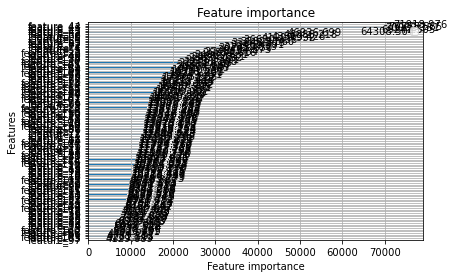

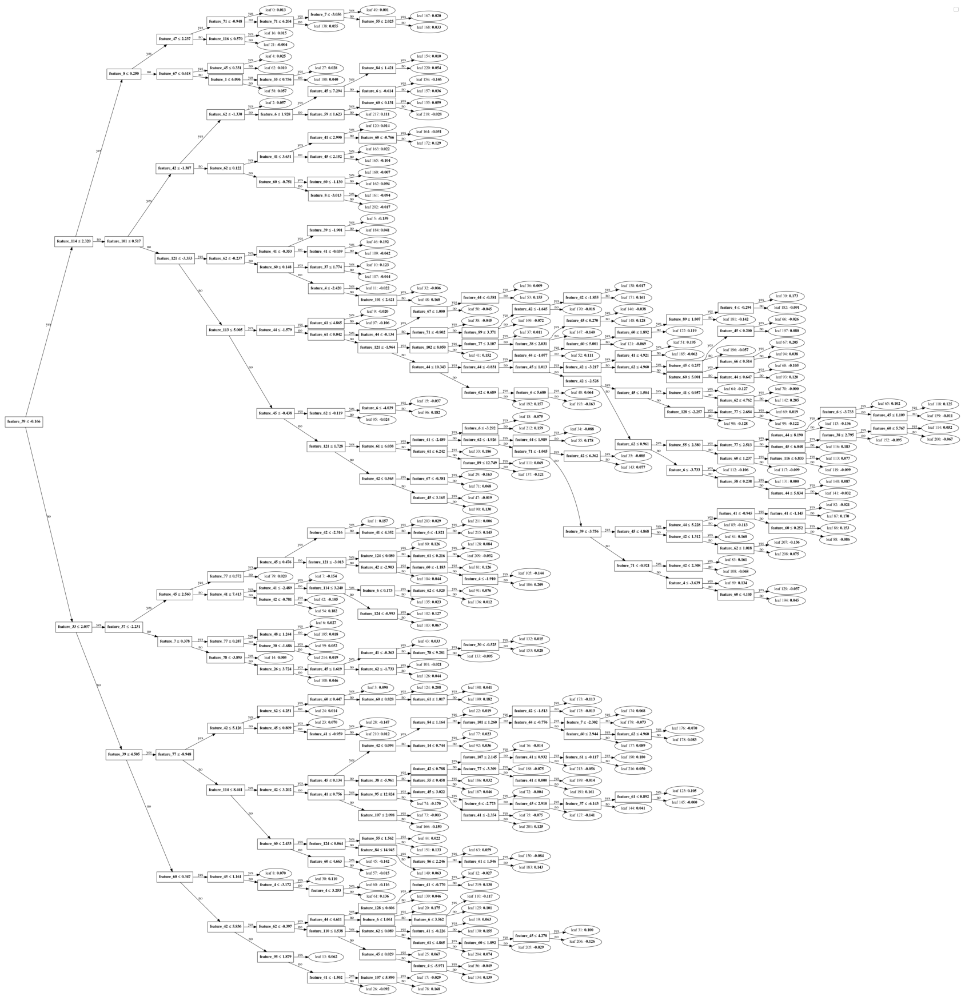

CPU times: user 12.4 s, sys: 1.42 s, total: 13.9 s
Wall time: 15.7 s


In [28]:
%%time
Plot_lgb(Class)

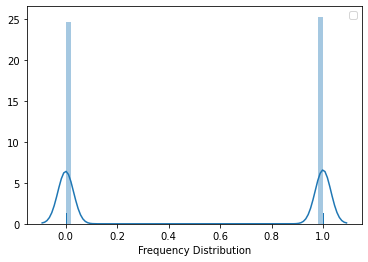

CPU times: user 12.7 s, sys: 537 ms, total: 13.3 s
Wall time: 13.3 s


In [29]:
%%time
distribution(y_true)

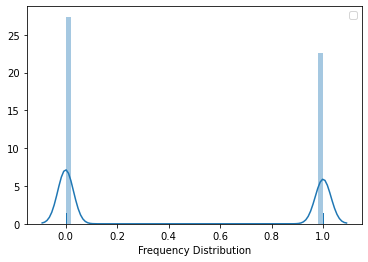

CPU times: user 13.1 s, sys: 845 ms, total: 13.9 s
Wall time: 14 s


In [30]:
%%time
distribution(y_pred_boot)

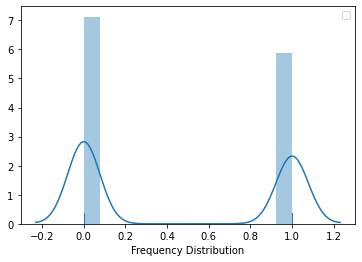

CPU times: user 275 ms, sys: 14.6 ms, total: 290 ms
Wall time: 293 ms


In [31]:
%%time
distribution(y_pred[target])

# Appendex
## A-1. Reconfirm the rules of [Jane Street Market Prediction](https://www.kaggle.com/c/jane-street-market-prediction/overview)
### Quote: [Jane Street| Details(explained) | EDA | Metric](https://www.kaggle.com/mrutyunjaybiswal/jane-street-details-explained-eda-metrics)

## A-1.1. Brief Description
### A-1.1.1. About
Developing trading strategies to identify and take advantage of inefficiencies is challenging. Even if a strategy is profitable now, it may not be in the future, and market volatility makes it impossible to predict the profitability of any given trade with certainty. As a result, it can be hard to distinguish good luck from having made a good trading decision.

In the first three months of this challenge, you will build your own quantitative trading model to maximize returns using market data from a major global stock exchange. Next, you’ll test the predictiveness of your models against future market returns and receive feedback on the leaderboard.

### A-1.1.2. Challenge Brief
Your challenge will be to use the historical data, mathematical tools, and technological tools at your disposal to create a model that gets as close to certainty as possible. You will be presented with a number of potential trading opportunities, which your model must choose whether to accept or reject.

In general, if one is able to generate a highly predictive model which selects the right trades to execute, they would also be playing an important role in sending the market signals that push prices closer to “fair” values. That is, a better model will mean the market will be more efficient going forward. However, developing good models will be challenging for many reasons, including a very low signal-to-noise ratio, potential redundancy, strong feature correlation, and difficulty of coming up with a proper mathematical formulation.

### A-1.1.3. Organizers
Jane Street has spent decades developing their own trading models and machine learning solutions to identify profitable opportunities and quickly decide whether to execute trades. These models help Jane Street trade thousands of financial products each day across 200 trading venues around the world.
Admittedly, this challenge far oversimplifies the depth of the quantitative problems Jane Streeters work on daily, and Jane Street is happy with the performance of its existing trading model for this particular question. However, there’s nothing like a good puzzle, and this challenge will hopefully serve as a fun introduction to a type of data science problem that a Jane Streeter might tackle on a daily basis. Jane Street looks forward to seeing the new and creative approaches the Kaggle community will take to solve this trading challenge.

## A-1.2. Evaluation and Submission
### A-1.2.1 Metric
### Utility Score
Each row in the test set represents a trading opportunity for which we will be predicting an action value, **1 to make the trade and 0 to pass on it**. Each trade j has an associated weight and resp, which represents a return.
For each date i, we define:
more_vert
$$ p_i = \sum_j(weight_{ij} * resp_{ij} * action_{ij}), $$
$$ t = \frac{\sum p_i }{\sqrt{\sum p_i^2}} * \sqrt{\frac{250}{|i|}}, $$
where $|i|$ is the number of unique dates in the test set. The utility is then defined as:
$$u = min(max(t,0), 6)  \sum p_i.$$

### A-1.2.2 Submission
```
import janestreet
env = janestreet.make_env() # initialize the environment
iter_test = env.iter_test() # an iterator which loops over the test set

for (test_df, sample_prediction_df) in iter_test:
    sample_prediction_df.action = 0 #make your 0/1 prediction here
    env.predict(sample_prediction_df)
```
### A-1.2.3 Code Requirements
Yes, this is a code competition, hence it has certain requirements for submission. Submissions to this competition must be made through Notebooks. For this competition, training is not required in Notebooks. In order for to be eligible for submission, the following conditions must be met:

### Training Phase
- Your notebook must use the time-series module to make predictions
- CPU Notebook <= 4 hours run-time
- GPU Notebook <= 4 hours run-time
- Freely & publicly available external data is allowed, including pre-trained models

### Forecasting Phase
Because the size of the test set will change during the live forecasting phase, the time limits will be adjusted in proportion to the test set size, with a **10% added time allowance**. As a hypothetical example, if there are <span style="color:red">1,000,000 test rows</span> and a <span style="color:red">4 hour runtime</span> limit during the **training phase** and the **forecasting phase** has <span style="color:red">2,000,000 rows</span>, your notebook will be allowed **8 hours + 10% = 8.8 hours during the forecasting phase**.

This dataset contains an anonymized set of features, <span style="color:red">feature_{0...129}</span>, representing real stock market data. 
1. Each row in the dataset represents a trading opportunity, for which you will be predicting an action value: 
    - 1 to make the trade and 
    - 0 to pass on it. 

2. Each trade has an associated <span style="color:red">weight and resp</span>, which together represents a return on the trade. 
3. The `date column` is an **integer** which represents the day of the trade.
4. The `ts_id` represents a time ordering. 
5. In addition to anonymized feature values, you are provided with metadata about the features in `features.csv`.

## A-1.3. Data Overview
### A-1.3.1. Train.csv
- In the training set, train.csv, you are provided a resp value, as well as several other resp_{1,2,3,4} values that represent returns over different time horizons. These variables are not included in the test set. 
- **Non-Scored:** Trades with weight = 0 were intentionally included in the dataset for completeness, although such trades will not contribute towards the scoring evaluation.

### A-1.3.2. Test Set
- During the model training phase of the competition, this unseen test set is comprised of historical data.
- During the live forecasting phase, the test set will use periodically updated live market data.
- Note that during the second (forecasting) phase of the competition, the notebook time limits will scale with the number of trades presented in the test set.
    1. **example_test.csv** - a mock test set which represents the structure of the unseen test set. You will not be directly using the test set or sample submission in this competition, as the time-series API will get/set the test set and predictions.
    2. **example_sample_submission.csv** - a mock sample submission file in the correct format

## A-2. References:
- [Approx. Utility score for Regression Objective Fnc](https://www.kaggle.com/anlgrbz/approx-utility-score-for-regression-objective-fnc#Custom-Objective-Function-Implementations-for-LGBM)
- [Jane Street Market - Baseline Logistic Regression](https://www.kaggle.com/abiolatti/jane-street-market-baseline-logistic-regression/notebook)
- [Jane Street Market Prediction. XGB + KFold + RFE](https://www.kaggle.com/isaienkov/jane-street-market-prediction-xgb-kfold-rfe)
- [Introduction of LightGBM Tuner with Optuna](https://www.kaggle.com/satorushibata/introduction-of-lightgbm-tuner-with-optuna)
- [LGBM Hyperparameter Tuning with Optuna (Beginners)](https://www.kaggle.com/saurabhshahane/lgbm-hyperparameter-tuning-with-optuna-beginners)
- [Market Prediction: XGBoost with GPU (Fit in 1min)](https://www.kaggle.com/hamditarek/market-prediction-xgboost-with-gpu-fit-in-1min)
- [Optimized LightGBM with Optuna adding SAKT Model](https://www.kaggle.com/satorushibata/optimized-lightgbm-with-optuna-adding-sakt-model)
- [Parameters](https://lightgbm.readthedocs.io/en/latest/Parameters.html)
- [lightgbm.train](https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.train.html)
- [lightgbm.LGBMClassifier](https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.LGBMClassifier.html#lightgbm.LGBMClassifier.set_params)
- [pandas.DataFrameのforループ処理（イテレーション）](https://note.nkmk.me/python-pandas-dataframe-for-iteration/)
- [Kaggleで役立つAdversarial Validationとは](https://www.acceluniverse.com/blog/developers/2020/01/kaggleadversarial-validation.html)
- [Using custom eval_metric with sklearn API](https://github.com/microsoft/LightGBM/issues/3029)
- [Support for multiple custom eval metrics](https://github.com/microsoft/LightGBM/issues/2182)
- [LightGBM ハンズオン - もう一つのGradient Boostingライブラリ](https://qiita.com/TomokIshii/items/3729c1b9c658cc48b5cb)
- [Logistic Regression on LightGBM Classifier](https://stackoverflow.com/questions/58572495/how-to-implement-custom-logloss-with-identical-behavior-to-binary-objective-in-l)